In [1]:
import torch
import torchvision
from torch import nn
from torch.utils.tensorboard import SummaryWriter
device = 'mps'

In [2]:
def show_tensor_images(image_tensor, num_images=32, size=(3, 64, 64), title='Fake Images'):

    image_unflat = image_tensor.detach().cpu().view(-1, *size)
    image_grid = torchvision.utils.make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.title(title)
    plt.show()

In [3]:
class Discriminator(nn.Module):
    
    def __init__(self, image_channels, features_d):
        super(Discriminator, self).__init__()
        
        self.disc = nn.Sequential(
        nn.Conv2d(image_channels, features_d, 4, 2, 1),
        nn.LeakyReLU(0.2),   
        self._block(features_d, features_d*2, 4, 2, 1),
        self._block(features_d*2, features_d*4, 4, 2, 1),
        self._block(features_d*4, features_d*8, 4, 2, 1),
        nn.Conv2d(features_d*8, 1, 4, 2, 0),
        nn.Sigmoid()
        )
        
    def _block(self, in_channels, out_channels, kernel_size, stride, padding):
        return nn.Sequential(
        nn.Conv2d(in_channels, out_channels, kernel_size, stride, padding, bias=False),
        nn.BatchNorm2d(out_channels),
        nn.LeakyReLU(0.2))
    
    def forward(self, x):
        return self.disc(x)

In [4]:
disc = Discriminator(3, 64).to(device)
x = torch.randn(32, 3, 64, 64).to(device)

out = disc(x)
out.shape

torch.Size([32, 1, 1, 1])

In [5]:
class Generator(nn.Module):
    def __init__(self, z_dim, image_channels, features_g):
        super(Generator, self).__init__()
        
        self.gen = nn.Sequential(
        self._block(z_dim, features_g*16, 4, 1, 0),
        self._block(features_g*16, features_g*8, 4, 2, 1),
        self._block(features_g*8, features_g*4, 4, 2, 1),
        self._block(features_g*4, features_g*2, 4, 2, 1),
        nn.ConvTranspose2d(features_g*2, image_channels, 4, 2, 1),
        nn.Tanh()
        )
        
    def _block(self, in_channels, out_channels, kernel_size, stride, padding):
        return nn.Sequential(
        nn.ConvTranspose2d(in_channels, out_channels, kernel_size, stride, padding, bias=False),
        nn.BatchNorm2d(out_channels),
        nn.ReLU())
    
    def forward(self, x):
        return self.gen(x)

In [6]:
gen = Generator(100, 3, 64).to(device)
x = torch.randn(32, 100, 1, 1).to(device)

out = gen(x)
out.shape

torch.Size([32, 3, 64, 64])

In [7]:
def initialize_weights(model):

    for m in model.modules():
        if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d, nn.BatchNorm2d)):
            nn.init.normal_(m.weight.data, 0.0, 0.02)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


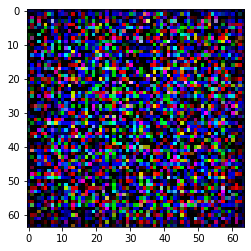

In [8]:
import matplotlib.pyplot as plt

plt.imshow(out[0].cpu().detach().permute(1, 2, 0), cmap='gray')

In [9]:
lr = 2e-4
batch_size = 128
image_size = 64
image_channels = 3
features = 64
z_dim = 100
n_epochs = 15

In [10]:
import torchvision

transforms = torchvision.transforms.Compose([
    torchvision.transforms.Resize((image_size, image_size)),
    torchvision.transforms.ToTensor(),
    torchvision.transforms.Normalize([0.5 for _ in range(image_channels)], [0.5 for _ in range(image_channels)])
])

In [11]:
# from google.colab import drive
# drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# !unzip /content/drive/MyDrive/Faces.zip

In [13]:
dataset = torchvision.datasets.ImageFolder(root='Datasets/CelebA/', transform=transforms)

In [14]:
loader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=True)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


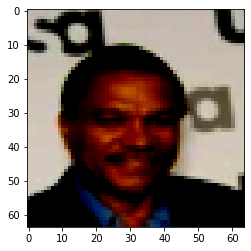

In [15]:
plt.imshow(next(iter(loader))[0][0].permute(1, 2, 0), cmap='gray')

In [16]:
disc = Discriminator(image_channels, features).to(device)
gen = Generator(z_dim, image_channels, features).to(device)
initialize_weights(disc)
initialize_weights(gen)

opt_disc = torch.optim.Adam(disc.parameters(), lr=lr, betas=(0.5, 0.999))
opt_gen = torch.optim.Adam(gen.parameters(), lr=lr, betas=(0.5, 0.999))
criterion = nn.BCELoss()
fixed_noise = torch.randn((32, z_dim, 1, 1)).to(device)

In [17]:
gen.train()
disc.train()

Discriminator(
  (disc): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.2)
    (2): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2)
    )
    (3): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2)
    )
    (4): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2)
    )
    (5): Conv2d(512, 1, kernel_size=(4, 4), stride=(2, 2))
    (6): Sigmoid()
  )
)

  0%|          | 0/1583 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


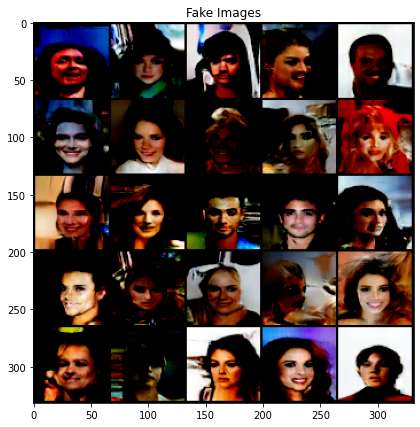

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


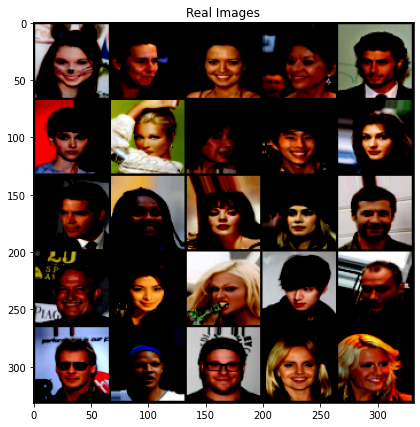

  0%|          | 2/1583 [00:01<13:55,  1.89it/s]


Epoch [1/15], Step 1 
Discriminator Loss: 0.2261, Generator Loss: 2.1161


 19%|█▉        | 300/1583 [01:49<07:57,  2.69it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


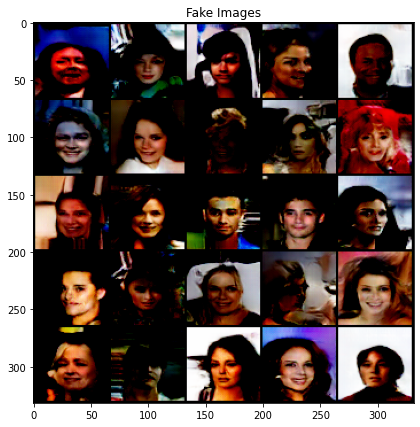

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


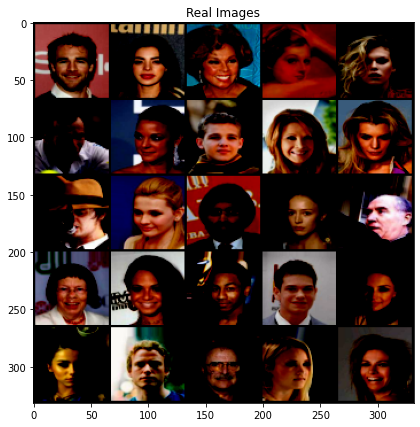

 19%|█▉        | 302/1583 [01:51<10:09,  2.10it/s]


Epoch [1/15], Step 2 
Discriminator Loss: 0.1724, Generator Loss: 2.3590


 38%|███▊      | 600/1583 [03:43<06:12,  2.64it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


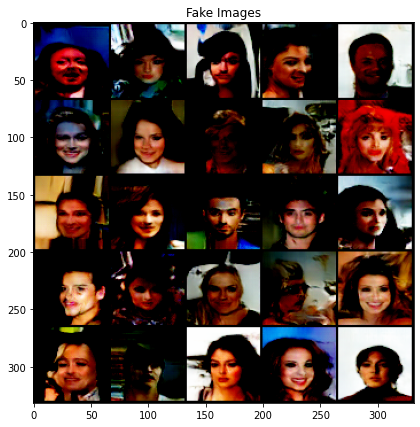

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


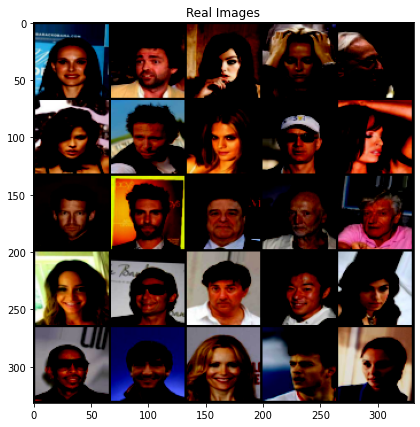

 38%|███▊      | 602/1583 [03:44<07:56,  2.06it/s]


Epoch [1/15], Step 3 
Discriminator Loss: 0.1512, Generator Loss: 3.4767


 57%|█████▋    | 900/1583 [05:38<04:21,  2.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


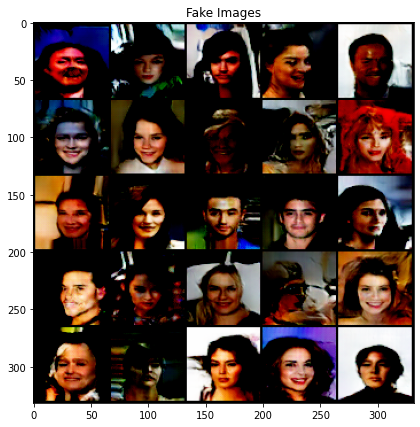

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


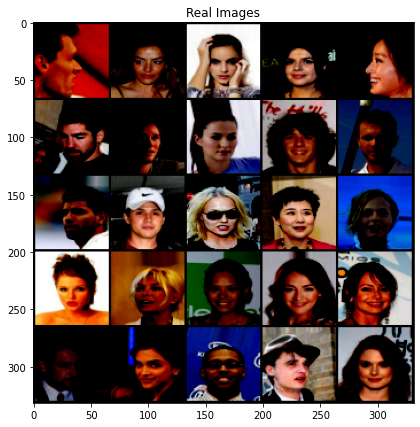

 57%|█████▋    | 902/1583 [05:40<05:33,  2.04it/s]


Epoch [1/15], Step 4 
Discriminator Loss: 0.1508, Generator Loss: 3.1673


 76%|███████▌  | 1200/1583 [07:34<02:26,  2.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


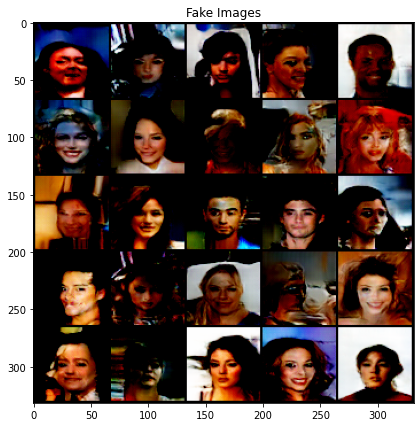

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


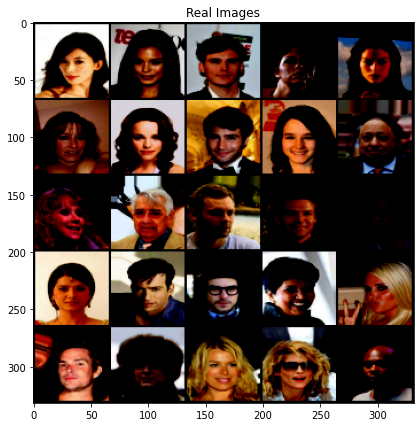

 76%|███████▌  | 1202/1583 [07:35<03:09,  2.01it/s]


Epoch [1/15], Step 5 
Discriminator Loss: 0.4909, Generator Loss: 1.0784


 95%|█████████▍| 1500/1583 [09:29<00:31,  2.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


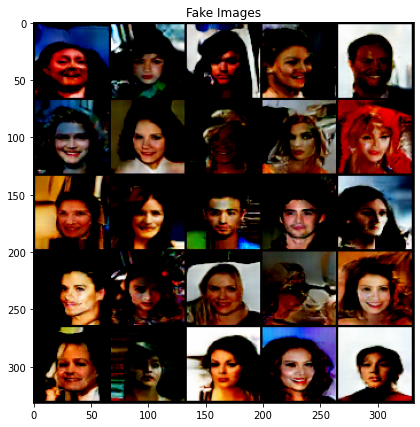

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


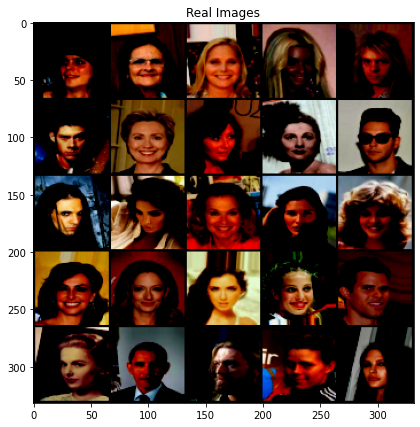

 95%|█████████▍| 1502/1583 [09:30<00:41,  1.95it/s]


Epoch [1/15], Step 6 
Discriminator Loss: 0.3142, Generator Loss: 4.2104


  0%|          | 0/1583 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


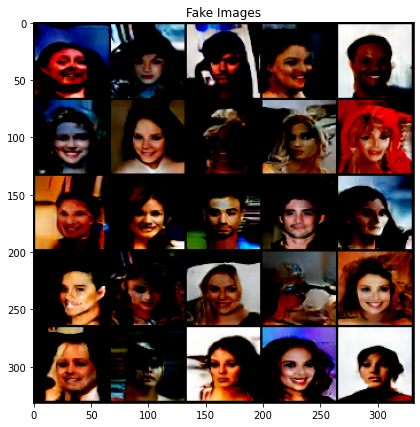

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


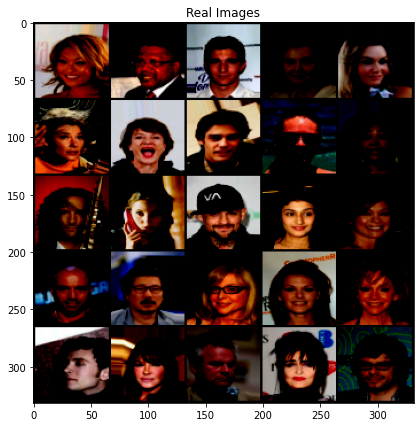

  0%|          | 2/1583 [00:01<15:24,  1.71it/s]


Epoch [2/15], Step 7 
Discriminator Loss: 0.2166, Generator Loss: 3.7999


 19%|█▉        | 300/1583 [01:55<08:09,  2.62it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


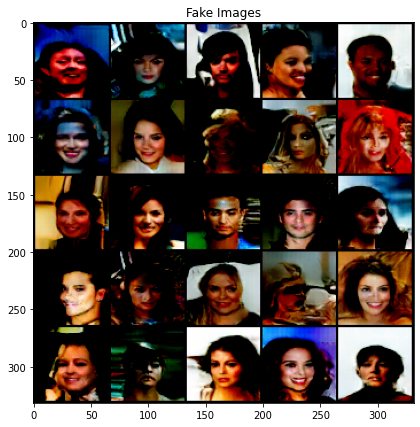

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


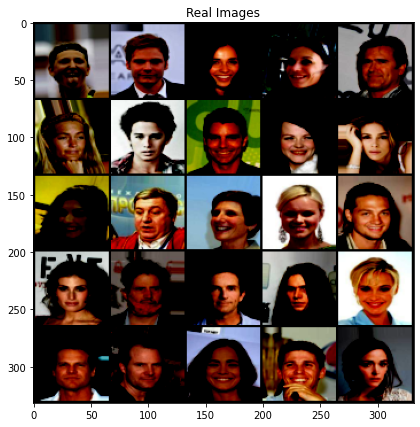

 19%|█▉        | 302/1583 [01:56<10:24,  2.05it/s]


Epoch [2/15], Step 8 
Discriminator Loss: 0.2785, Generator Loss: 2.0347


 38%|███▊      | 600/1583 [03:50<06:16,  2.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


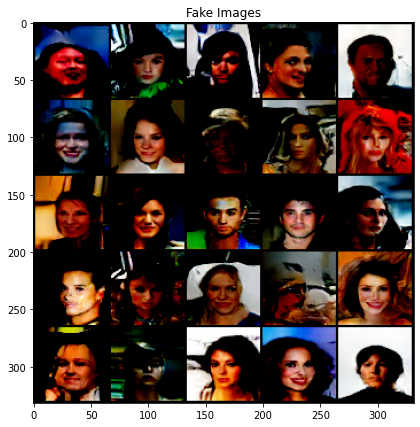

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


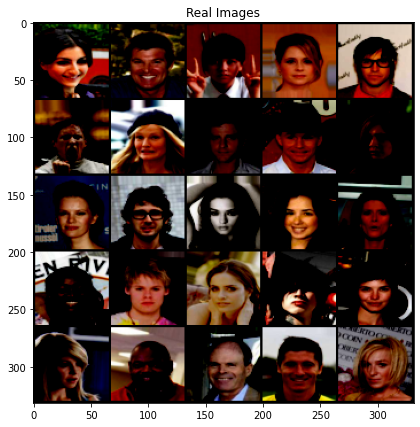

 38%|███▊      | 602/1583 [03:52<07:57,  2.05it/s]


Epoch [2/15], Step 9 
Discriminator Loss: 0.1197, Generator Loss: 1.8436


 57%|█████▋    | 900/1583 [05:46<04:21,  2.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


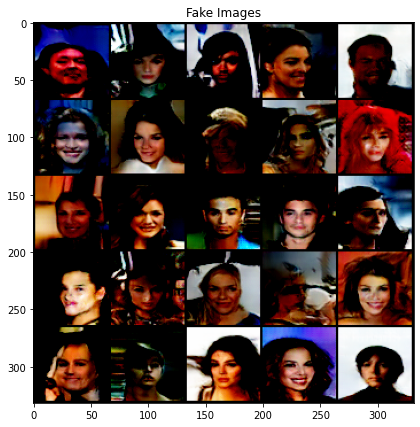

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


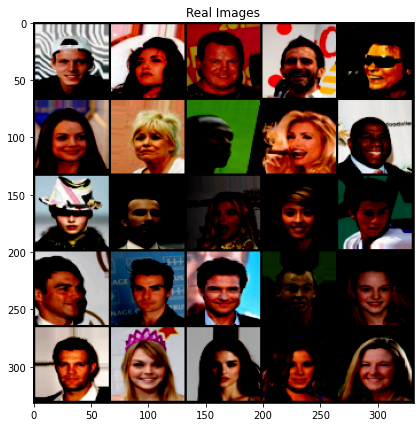

 57%|█████▋    | 902/1583 [05:47<05:34,  2.04it/s]


Epoch [2/15], Step 10 
Discriminator Loss: 0.2265, Generator Loss: 1.7532


 76%|███████▌  | 1200/1583 [07:41<02:26,  2.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


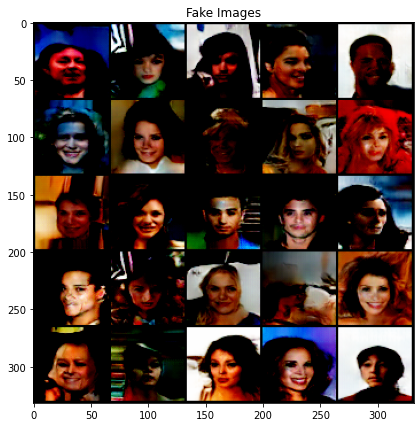

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


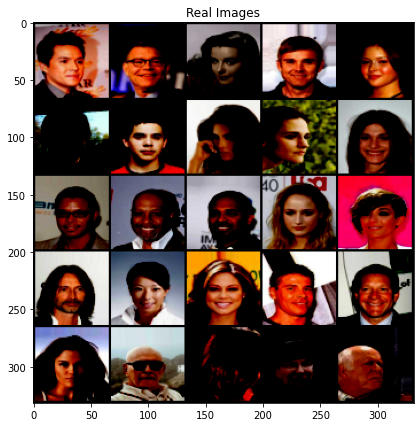

 76%|███████▌  | 1202/1583 [07:42<03:06,  2.04it/s]


Epoch [2/15], Step 11 
Discriminator Loss: 0.1491, Generator Loss: 1.9620


 95%|█████████▍| 1500/1583 [09:36<00:31,  2.62it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


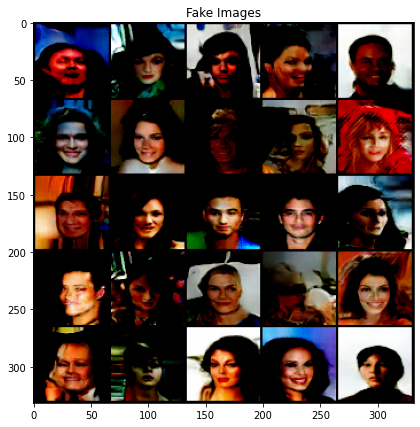

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


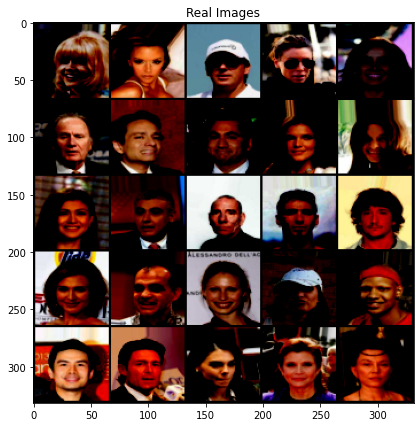

 95%|█████████▍| 1502/1583 [09:38<00:39,  2.04it/s]


Epoch [2/15], Step 12 
Discriminator Loss: 0.1150, Generator Loss: 2.9682


  0%|          | 0/1583 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


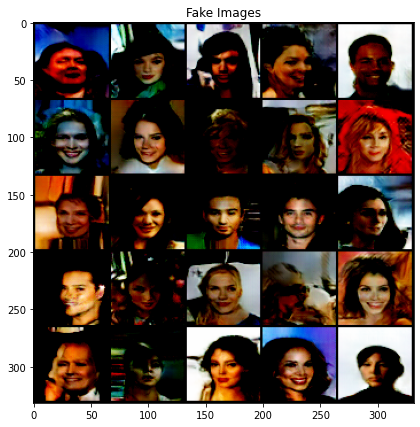

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


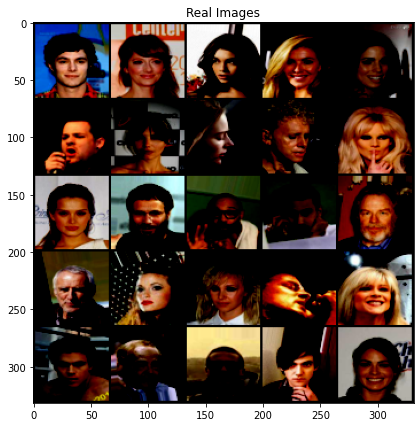

  0%|          | 2/1583 [00:01<16:32,  1.59it/s]


Epoch [3/15], Step 13 
Discriminator Loss: 0.1757, Generator Loss: 3.6761


 19%|█▉        | 300/1583 [01:55<08:09,  2.62it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


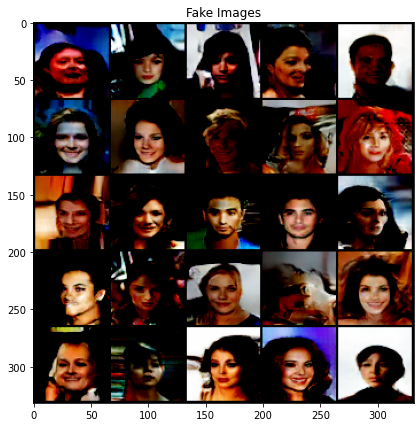

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


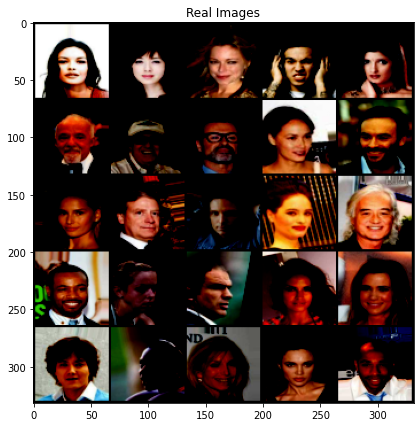

 19%|█▉        | 302/1583 [01:56<10:26,  2.05it/s]


Epoch [3/15], Step 14 
Discriminator Loss: 0.1001, Generator Loss: 3.4844


 38%|███▊      | 600/1583 [03:51<06:16,  2.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


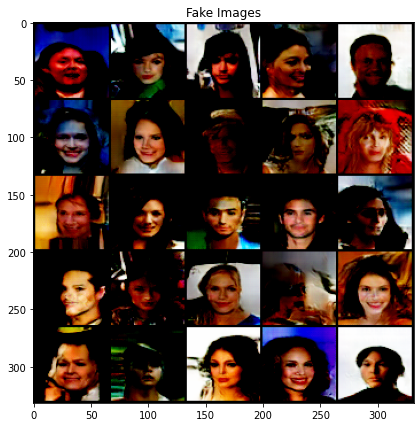

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


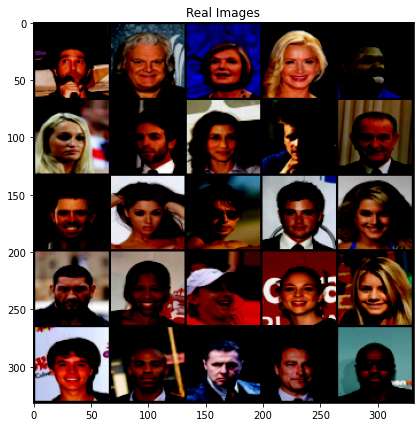

 38%|███▊      | 602/1583 [03:52<07:57,  2.05it/s]


Epoch [3/15], Step 15 
Discriminator Loss: 0.2886, Generator Loss: 1.5885


 57%|█████▋    | 900/1583 [05:46<04:20,  2.62it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


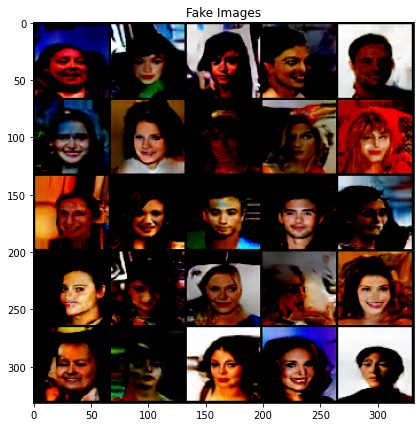

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


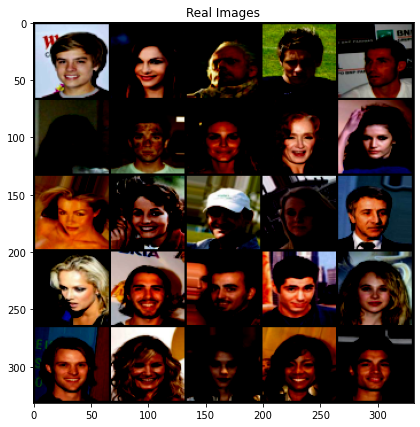

 57%|█████▋    | 902/1583 [05:47<05:35,  2.03it/s]


Epoch [3/15], Step 16 
Discriminator Loss: 0.1011, Generator Loss: 3.2340


 76%|███████▌  | 1200/1583 [07:41<02:27,  2.60it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


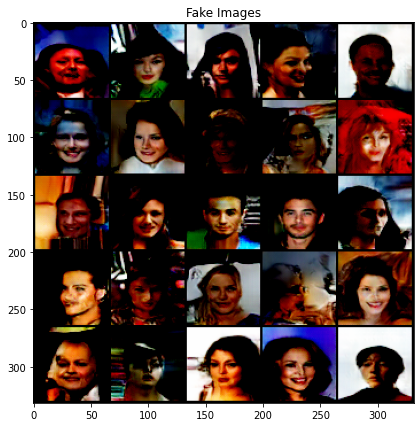

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


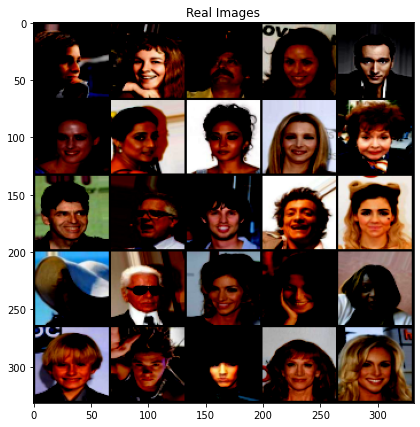

 76%|███████▌  | 1202/1583 [07:43<03:06,  2.04it/s]


Epoch [3/15], Step 17 
Discriminator Loss: 0.1333, Generator Loss: 2.8119


 95%|█████████▍| 1500/1583 [09:37<00:31,  2.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


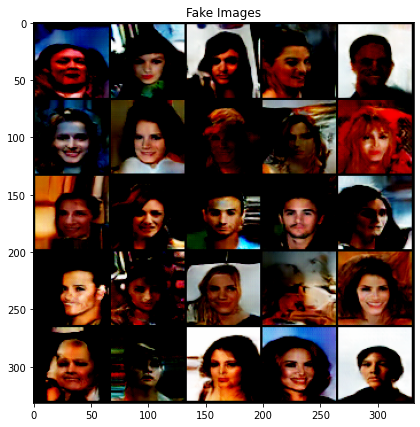

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


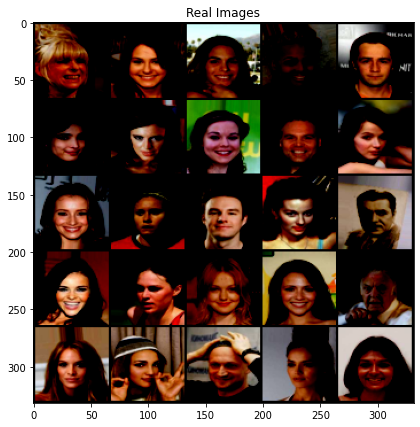

 95%|█████████▍| 1502/1583 [09:38<00:40,  2.01it/s]


Epoch [3/15], Step 18 
Discriminator Loss: 0.2081, Generator Loss: 2.2605


  0%|          | 0/1583 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


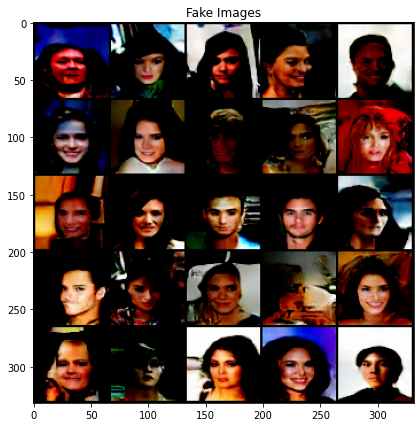

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


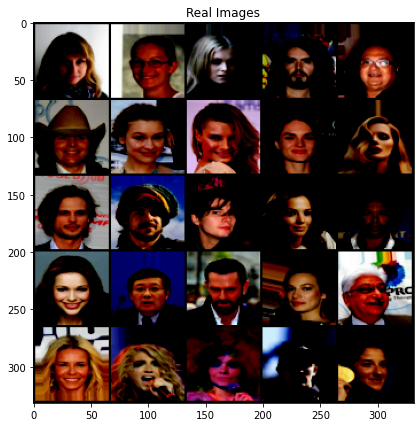

  0%|          | 2/1583 [00:01<15:26,  1.71it/s]


Epoch [4/15], Step 19 
Discriminator Loss: 0.2161, Generator Loss: 2.1847


 19%|█▉        | 300/1583 [01:55<08:11,  2.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


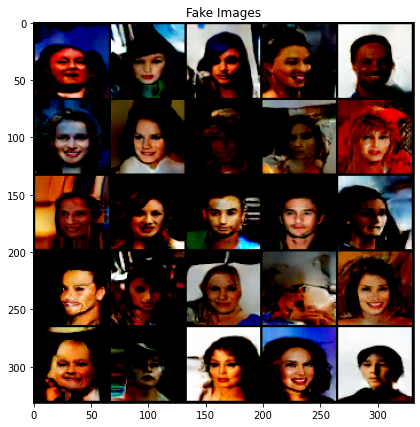

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


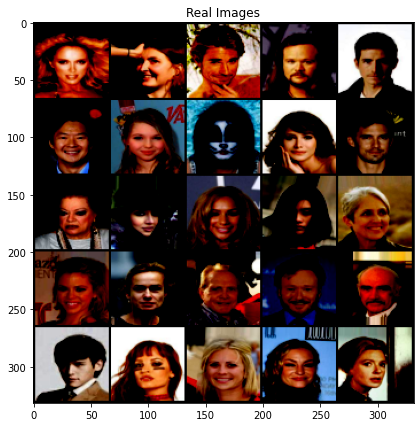

 19%|█▉        | 302/1583 [01:56<10:30,  2.03it/s]


Epoch [4/15], Step 20 
Discriminator Loss: 0.1239, Generator Loss: 2.9826


 38%|███▊      | 600/1583 [03:50<06:16,  2.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


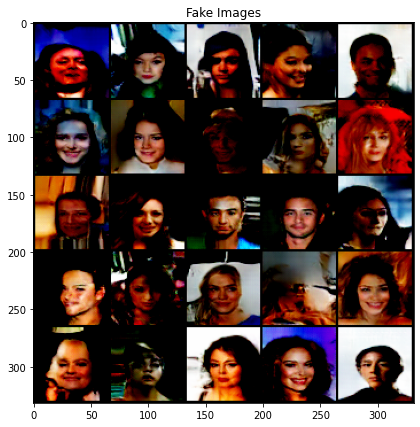

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


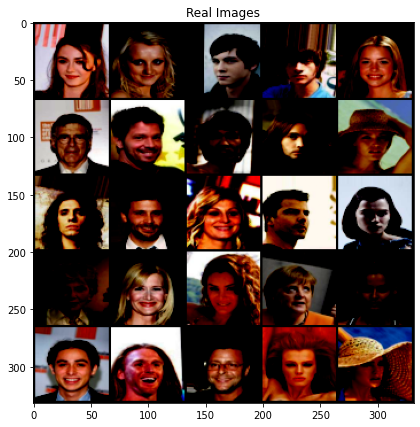

 38%|███▊      | 602/1583 [03:52<08:16,  1.97it/s]


Epoch [4/15], Step 21 
Discriminator Loss: 0.2561, Generator Loss: 1.0845


 57%|█████▋    | 900/1583 [05:46<04:21,  2.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


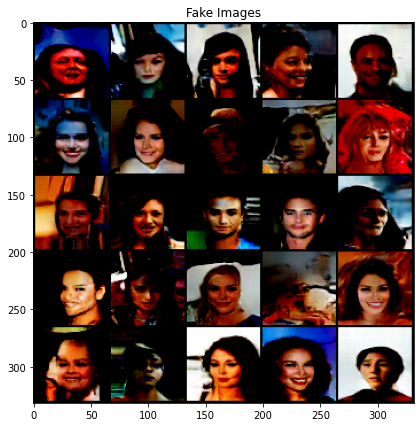

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


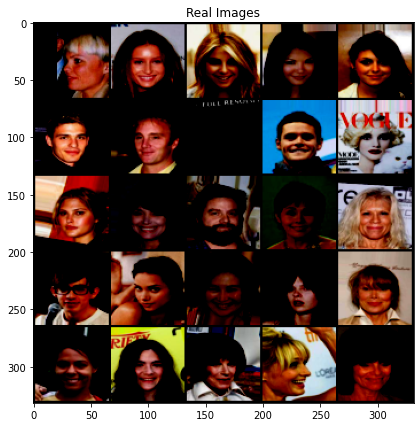

 57%|█████▋    | 902/1583 [05:47<05:34,  2.04it/s]


Epoch [4/15], Step 22 
Discriminator Loss: 0.2042, Generator Loss: 2.2478


 76%|███████▌  | 1200/1583 [07:41<02:26,  2.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


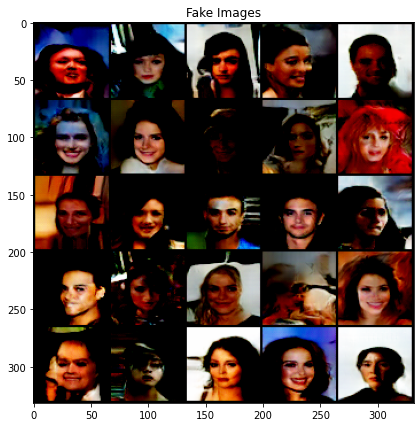

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


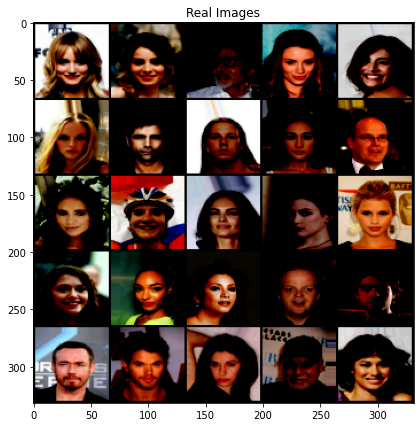

 76%|███████▌  | 1202/1583 [07:43<03:08,  2.03it/s]


Epoch [4/15], Step 23 
Discriminator Loss: 0.2512, Generator Loss: 2.0975


 95%|█████████▍| 1500/1583 [09:37<00:31,  2.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


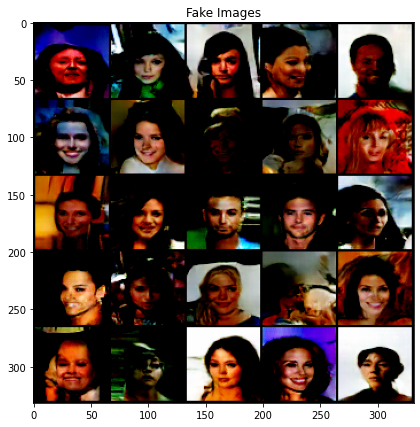

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


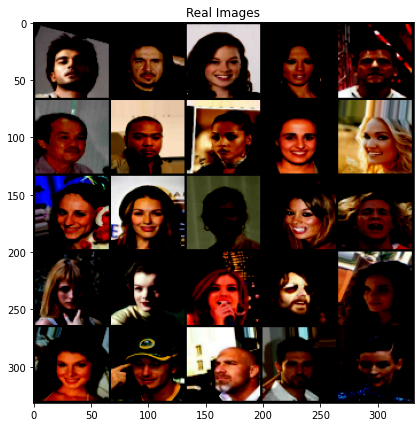

 95%|█████████▍| 1501/1583 [09:38<00:50,  1.61it/s]


Epoch [4/15], Step 24 
Discriminator Loss: 0.1684, Generator Loss: 4.5213


  0%|          | 0/1583 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


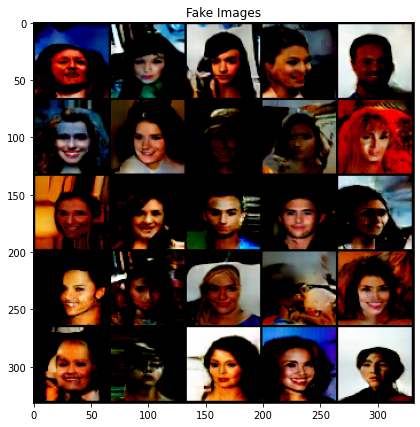

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


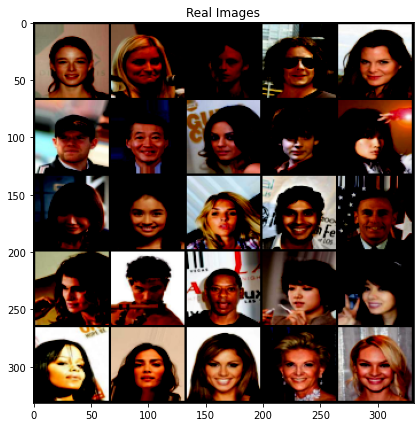

  0%|          | 2/1583 [00:01<15:36,  1.69it/s]


Epoch [5/15], Step 25 
Discriminator Loss: 0.3405, Generator Loss: 5.1796


 19%|█▉        | 300/1583 [01:55<08:12,  2.60it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


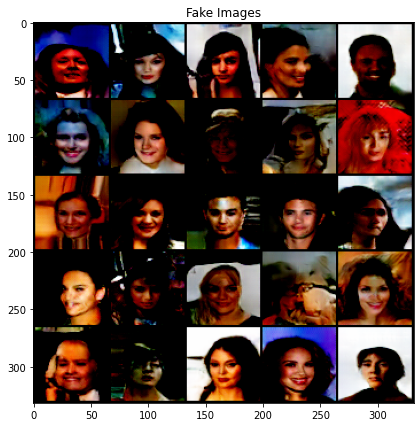

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


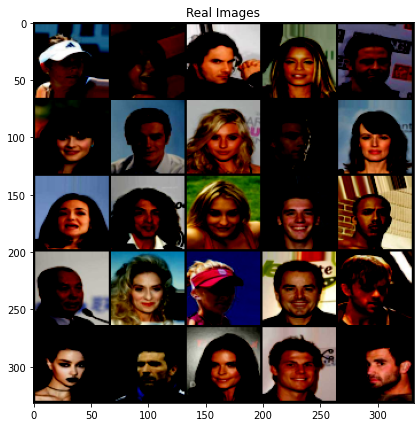

 19%|█▉        | 302/1583 [01:56<10:30,  2.03it/s]


Epoch [5/15], Step 26 
Discriminator Loss: 0.0848, Generator Loss: 3.2449


 38%|███▊      | 600/1583 [03:50<06:17,  2.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


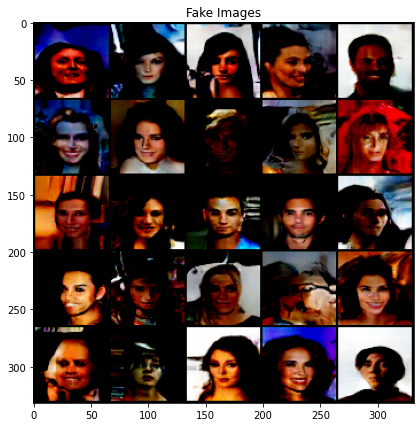

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


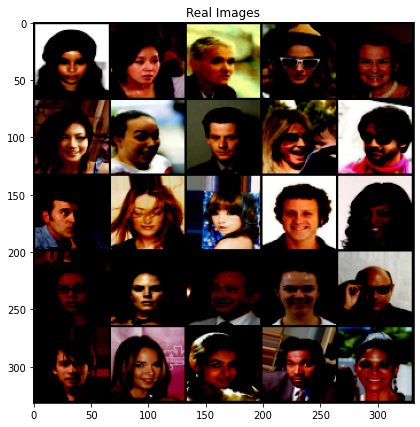

 38%|███▊      | 602/1583 [03:52<08:08,  2.01it/s]


Epoch [5/15], Step 27 
Discriminator Loss: 0.1213, Generator Loss: 3.2369


 57%|█████▋    | 900/1583 [05:46<04:20,  2.62it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


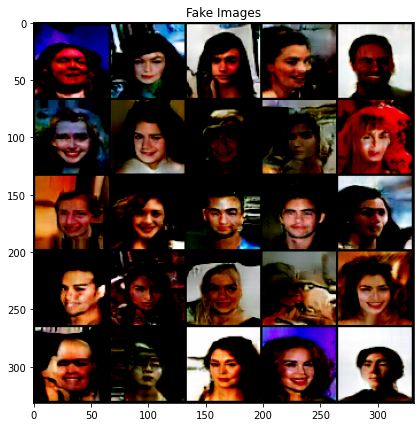

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


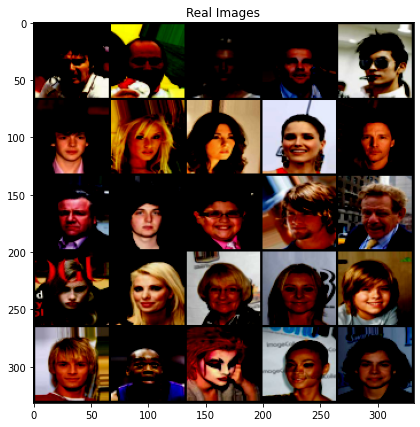

 57%|█████▋    | 902/1583 [05:47<05:48,  1.96it/s]


Epoch [5/15], Step 28 
Discriminator Loss: 0.2783, Generator Loss: 2.4168


 76%|███████▌  | 1200/1583 [07:41<02:26,  2.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


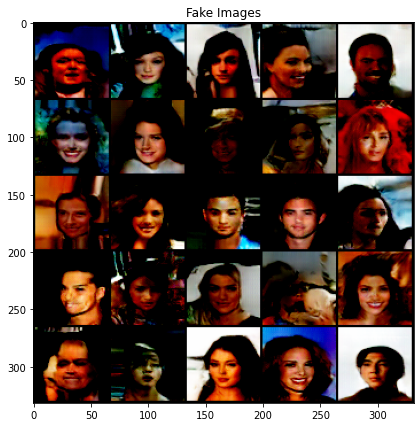

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


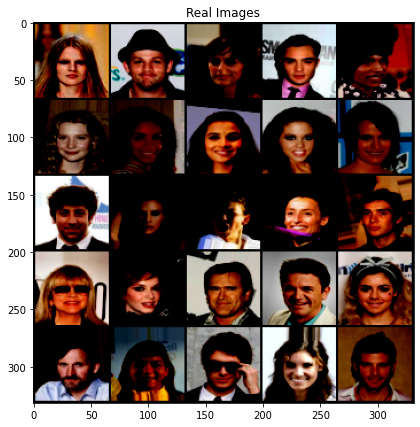

 76%|███████▌  | 1202/1583 [07:43<03:06,  2.04it/s]


Epoch [5/15], Step 29 
Discriminator Loss: 0.1574, Generator Loss: 2.8378


 95%|█████████▍| 1500/1583 [09:37<00:31,  2.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


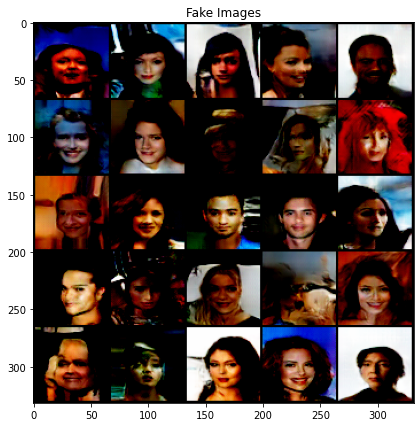

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


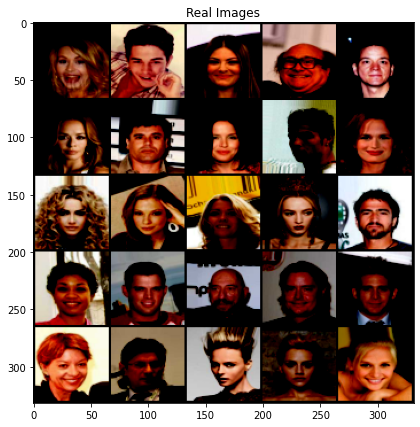

 95%|█████████▍| 1502/1583 [09:38<00:40,  1.98it/s]


Epoch [5/15], Step 30 
Discriminator Loss: 0.0882, Generator Loss: 3.4662


  0%|          | 0/1583 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


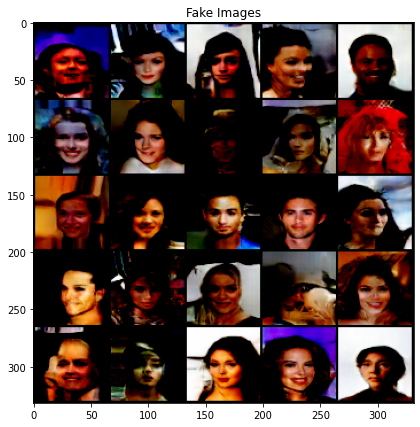

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


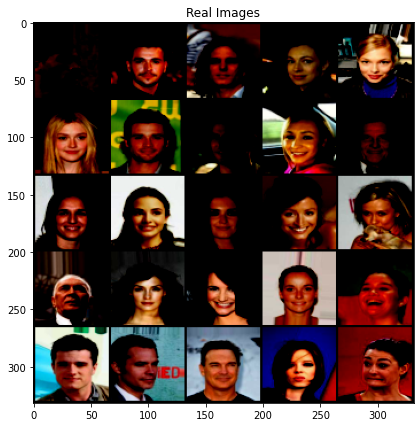

  0%|          | 2/1583 [00:01<15:31,  1.70it/s]


Epoch [6/15], Step 31 
Discriminator Loss: 0.1217, Generator Loss: 2.9510


 19%|█▉        | 300/1583 [01:55<08:11,  2.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


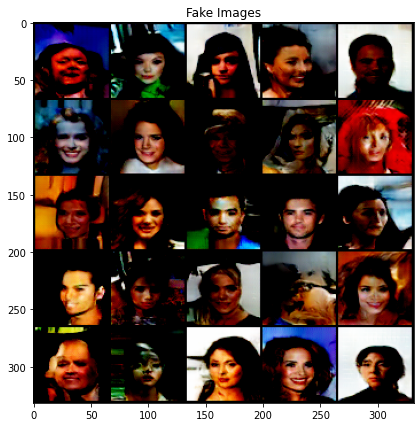

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


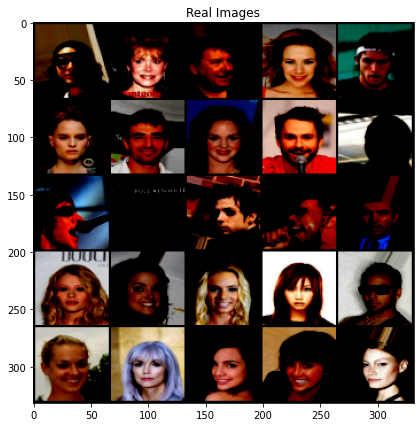

 19%|█▉        | 302/1583 [01:56<10:34,  2.02it/s]


Epoch [6/15], Step 32 
Discriminator Loss: 0.0913, Generator Loss: 3.1741


 38%|███▊      | 600/1583 [03:50<06:17,  2.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


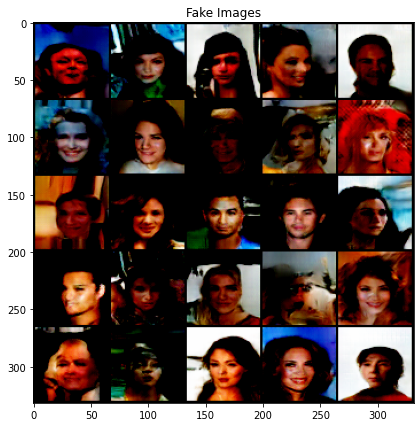

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


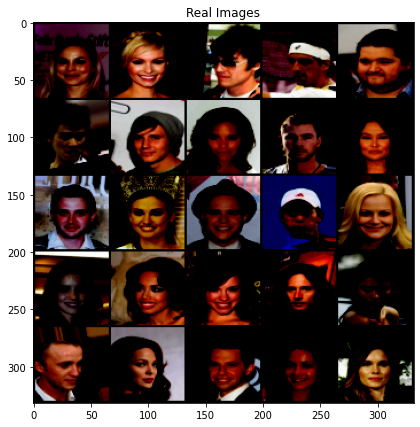

 38%|███▊      | 602/1583 [03:52<08:07,  2.01it/s]


Epoch [6/15], Step 33 
Discriminator Loss: 0.1285, Generator Loss: 2.9329


 57%|█████▋    | 900/1583 [05:46<04:21,  2.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


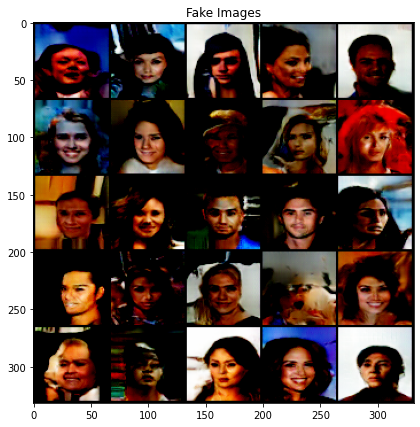

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


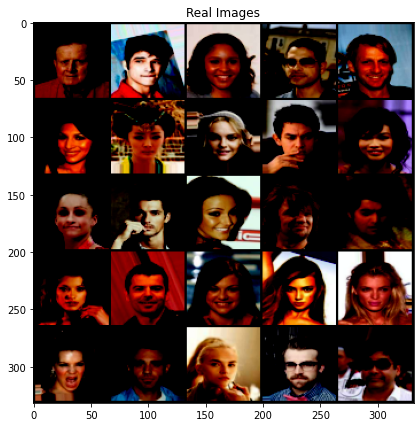

 57%|█████▋    | 902/1583 [05:47<05:32,  2.05it/s]


Epoch [6/15], Step 34 
Discriminator Loss: 0.1579, Generator Loss: 4.1488


 76%|███████▌  | 1200/1583 [07:41<02:26,  2.62it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


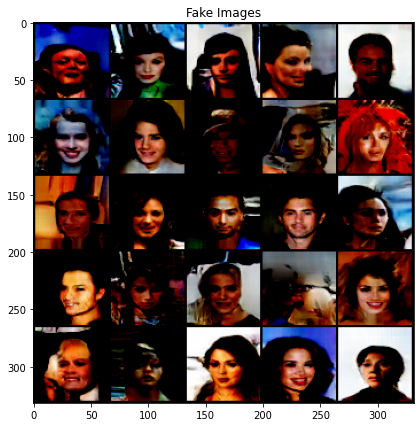

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


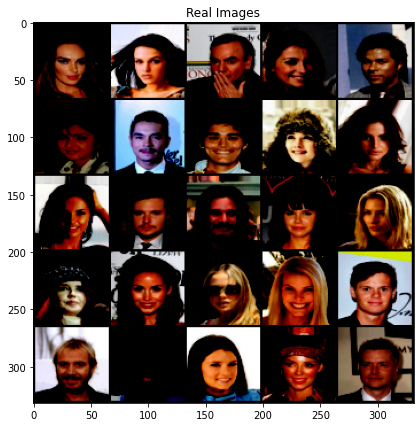

 76%|███████▌  | 1202/1583 [07:43<03:06,  2.04it/s]


Epoch [6/15], Step 35 
Discriminator Loss: 0.2833, Generator Loss: 4.6319


 95%|█████████▍| 1500/1583 [09:37<00:31,  2.59it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


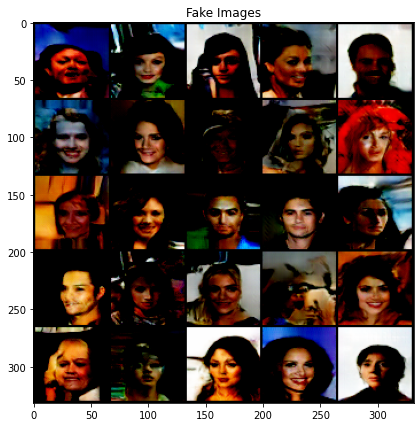

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


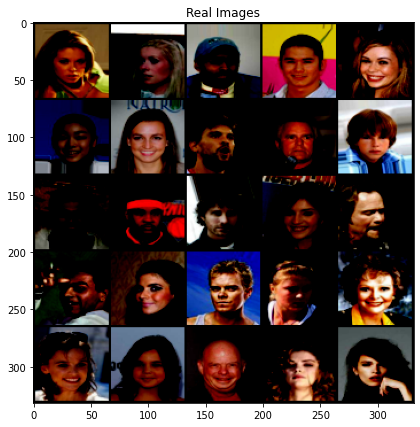

 95%|█████████▍| 1502/1583 [09:38<00:40,  1.98it/s]


Epoch [6/15], Step 36 
Discriminator Loss: 0.1317, Generator Loss: 3.6501


  0%|          | 0/1583 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


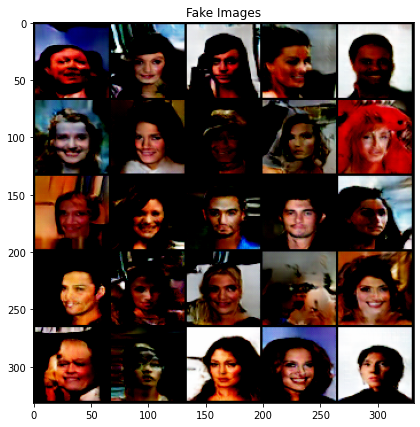

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


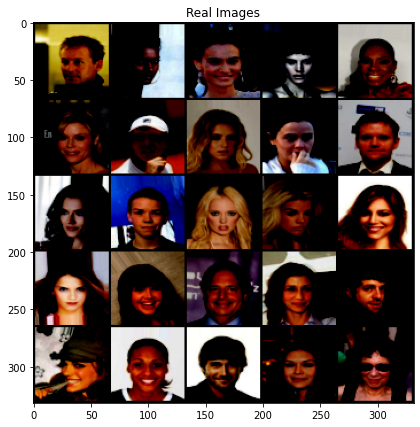

  0%|          | 2/1583 [00:01<15:35,  1.69it/s]


Epoch [7/15], Step 37 
Discriminator Loss: 0.4685, Generator Loss: 2.5402


 19%|█▉        | 300/1583 [01:55<08:10,  2.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


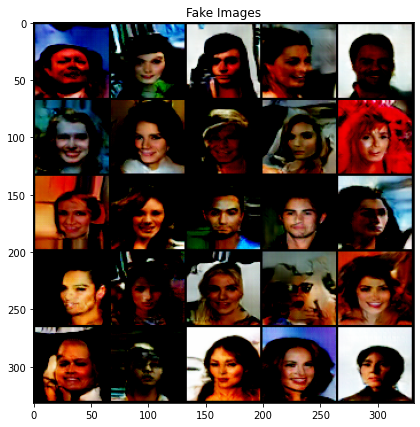

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


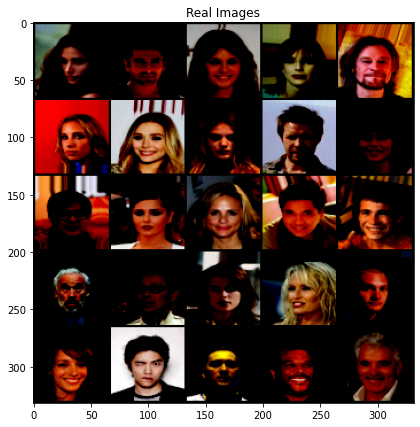

 19%|█▉        | 302/1583 [01:56<10:24,  2.05it/s]


Epoch [7/15], Step 38 
Discriminator Loss: 0.0897, Generator Loss: 2.7678


 38%|███▊      | 600/1583 [03:50<06:17,  2.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


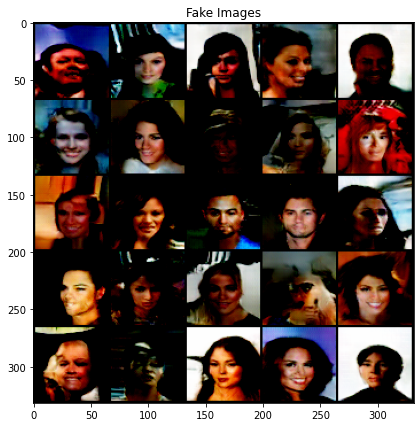

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


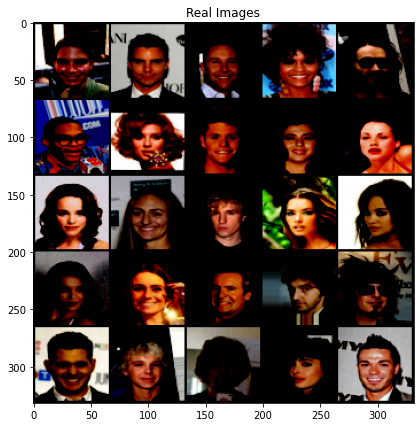

 38%|███▊      | 601/1583 [03:51<10:16,  1.59it/s]


Epoch [7/15], Step 39 
Discriminator Loss: 0.1199, Generator Loss: 3.5533


 57%|█████▋    | 900/1583 [05:46<04:21,  2.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


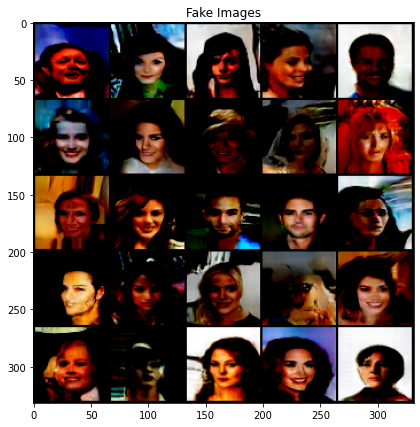

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


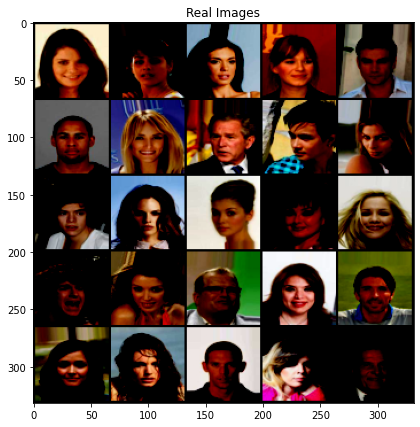

 57%|█████▋    | 901/1583 [05:47<07:13,  1.57it/s]


Epoch [7/15], Step 40 
Discriminator Loss: 0.3849, Generator Loss: 1.5538


 76%|███████▌  | 1200/1583 [07:41<02:26,  2.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


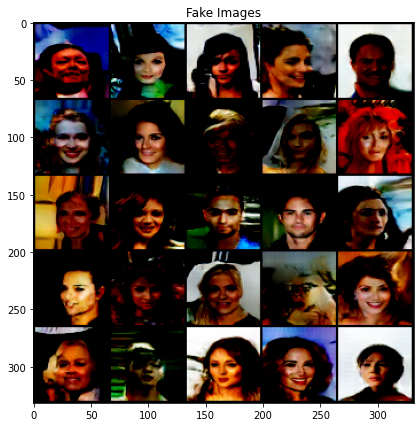

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


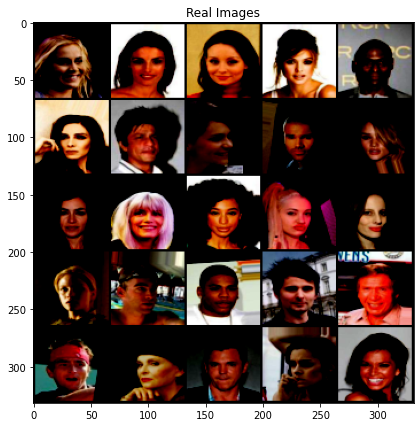

 76%|███████▌  | 1202/1583 [07:43<03:07,  2.04it/s]


Epoch [7/15], Step 41 
Discriminator Loss: 0.1565, Generator Loss: 2.2157


 95%|█████████▍| 1500/1583 [09:37<00:31,  2.62it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


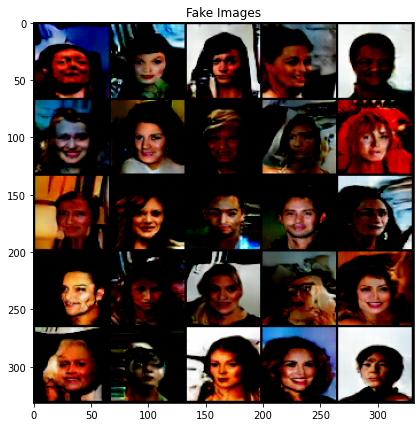

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


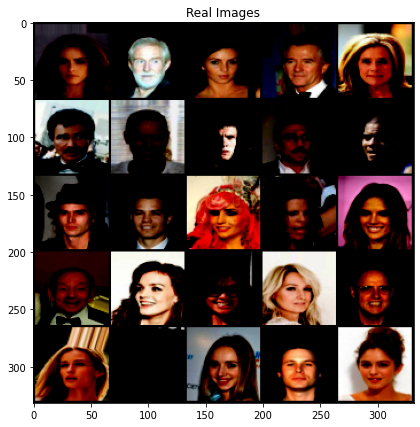

 95%|█████████▍| 1502/1583 [09:38<00:39,  2.05it/s]


Epoch [7/15], Step 42 
Discriminator Loss: 0.1311, Generator Loss: 2.6416


  0%|          | 0/1583 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


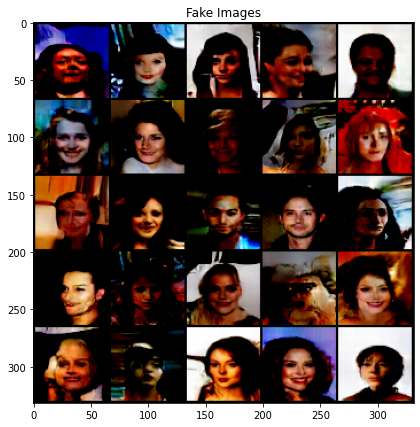

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


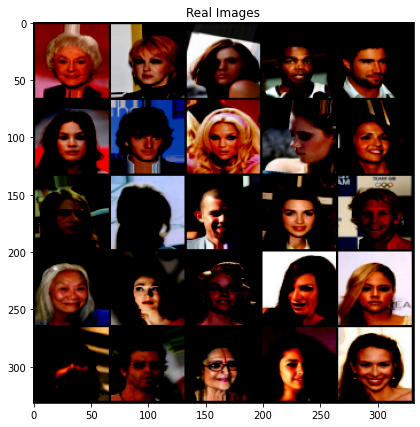

  0%|          | 2/1583 [00:01<16:25,  1.60it/s]


Epoch [8/15], Step 43 
Discriminator Loss: 0.1280, Generator Loss: 3.4816


 19%|█▉        | 300/1583 [01:55<08:09,  2.62it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


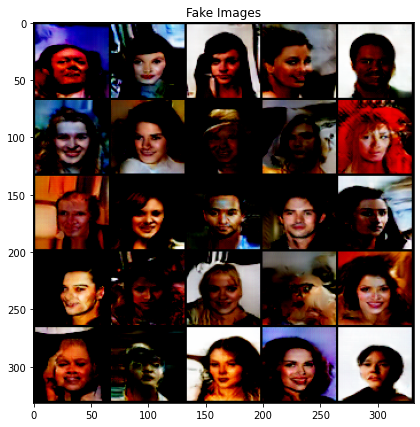

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


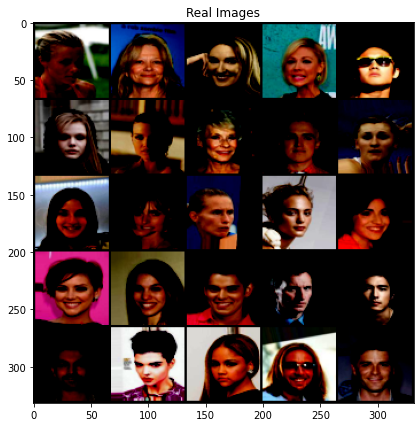

 19%|█▉        | 302/1583 [01:56<10:27,  2.04it/s]


Epoch [8/15], Step 44 
Discriminator Loss: 0.1971, Generator Loss: 3.5626


 38%|███▊      | 600/1583 [03:50<06:17,  2.60it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


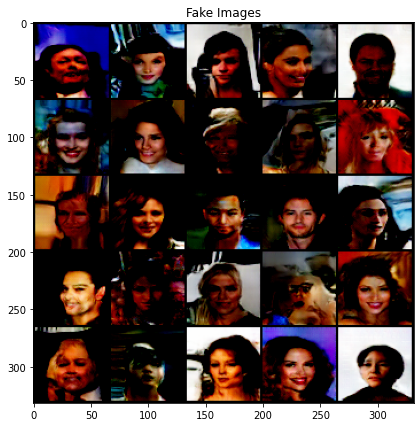

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


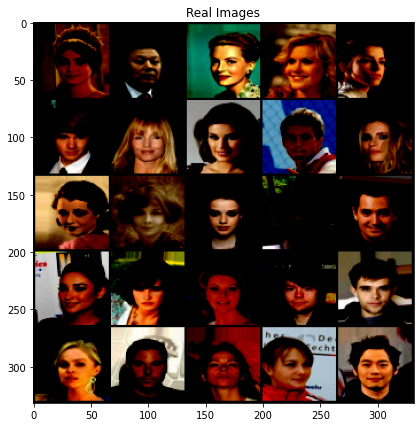

 38%|███▊      | 602/1583 [03:52<07:59,  2.05it/s]


Epoch [8/15], Step 45 
Discriminator Loss: 0.0674, Generator Loss: 3.6268


 57%|█████▋    | 900/1583 [05:46<04:20,  2.62it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


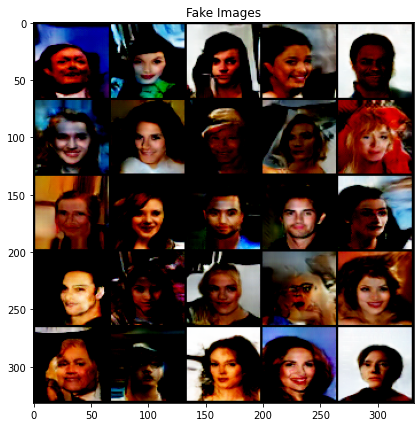

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


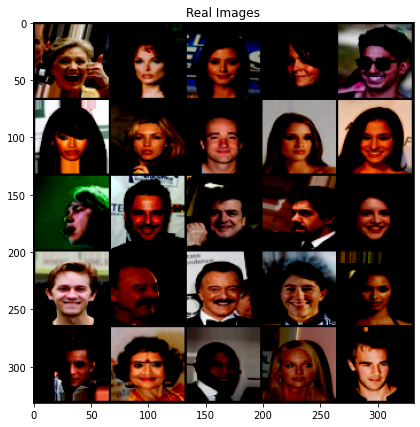

 57%|█████▋    | 902/1583 [05:47<05:33,  2.04it/s]


Epoch [8/15], Step 46 
Discriminator Loss: 0.0762, Generator Loss: 3.5154


 76%|███████▌  | 1200/1583 [07:41<02:26,  2.62it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


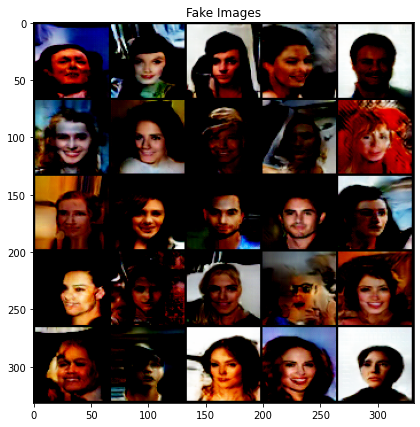

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


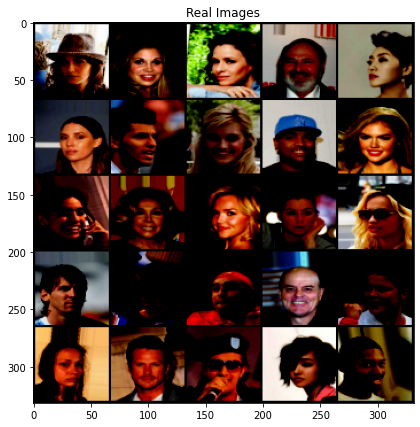

 76%|███████▌  | 1202/1583 [07:42<03:07,  2.03it/s]


Epoch [8/15], Step 47 
Discriminator Loss: 0.2193, Generator Loss: 2.9290


 95%|█████████▍| 1500/1583 [09:36<00:31,  2.62it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


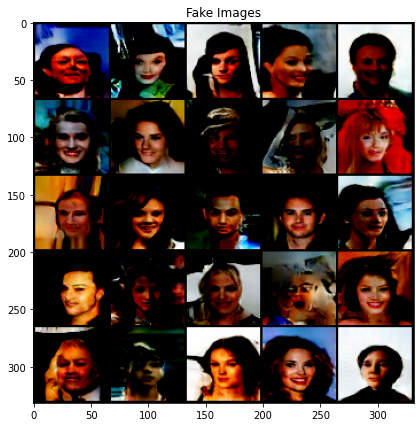

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


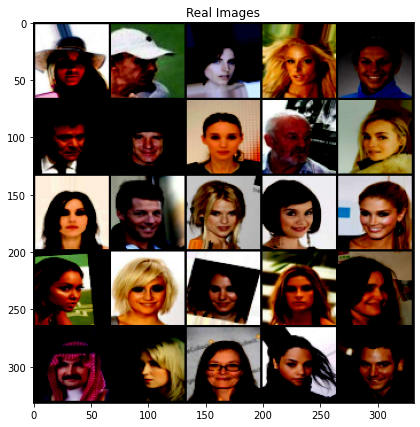

 95%|█████████▍| 1502/1583 [09:38<00:40,  2.01it/s]


Epoch [8/15], Step 48 
Discriminator Loss: 0.0946, Generator Loss: 3.0801


  0%|          | 0/1583 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


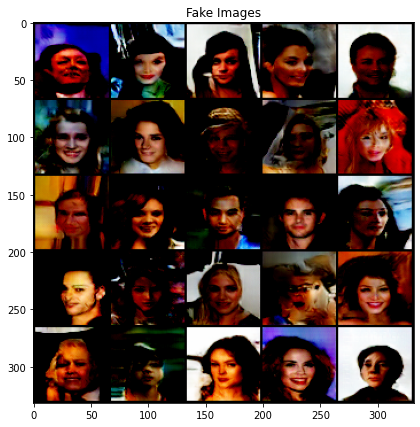

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


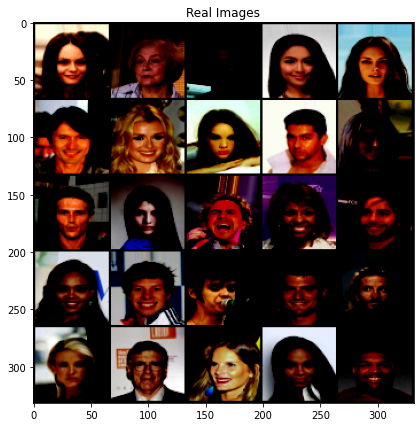

  0%|          | 2/1583 [00:01<15:26,  1.71it/s]


Epoch [9/15], Step 49 
Discriminator Loss: 0.1214, Generator Loss: 4.0345


 19%|█▉        | 300/1583 [01:55<08:13,  2.60it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


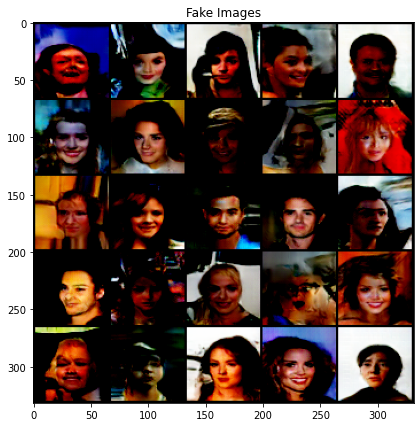

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


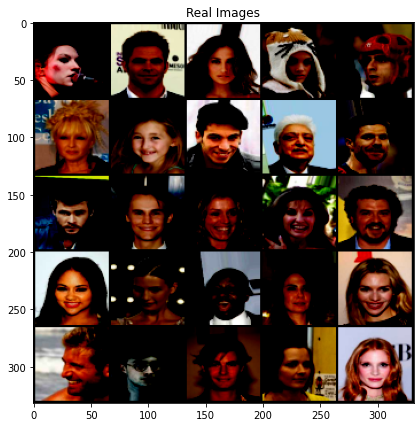

 19%|█▉        | 302/1583 [01:56<10:31,  2.03it/s]


Epoch [9/15], Step 50 
Discriminator Loss: 0.0991, Generator Loss: 4.2224


 38%|███▊      | 600/1583 [03:50<06:18,  2.60it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


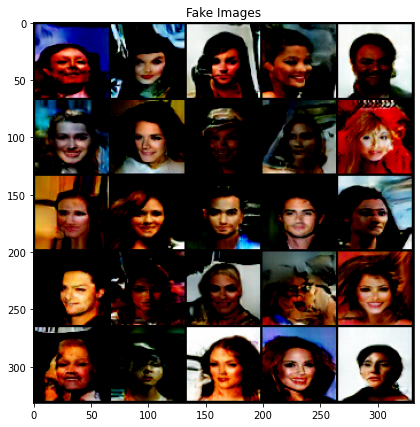

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


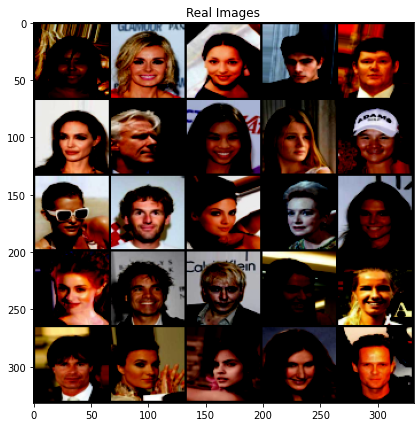

 38%|███▊      | 602/1583 [03:52<08:17,  1.97it/s]


Epoch [9/15], Step 51 
Discriminator Loss: 0.2657, Generator Loss: 5.4344


 57%|█████▋    | 900/1583 [05:46<04:20,  2.62it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


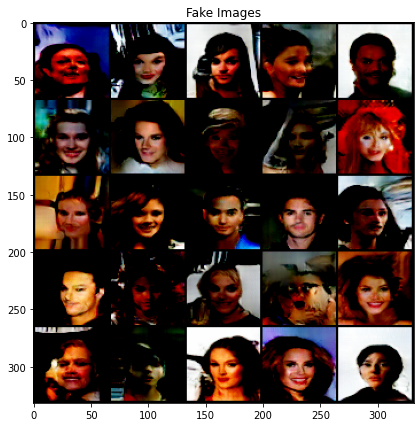

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


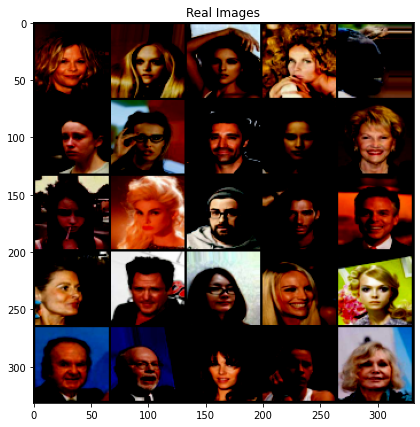

 57%|█████▋    | 902/1583 [05:47<05:33,  2.04it/s]


Epoch [9/15], Step 52 
Discriminator Loss: 0.1267, Generator Loss: 3.7975


 76%|███████▌  | 1200/1583 [07:41<02:25,  2.62it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


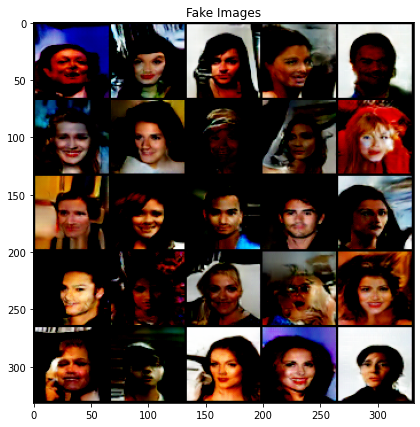

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


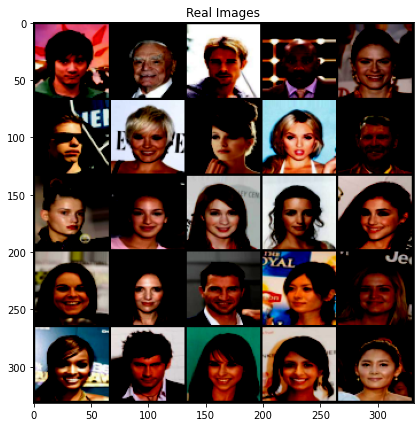

 76%|███████▌  | 1202/1583 [07:43<03:09,  2.01it/s]


Epoch [9/15], Step 53 
Discriminator Loss: 0.2438, Generator Loss: 1.0024


 95%|█████████▍| 1500/1583 [09:37<00:31,  2.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


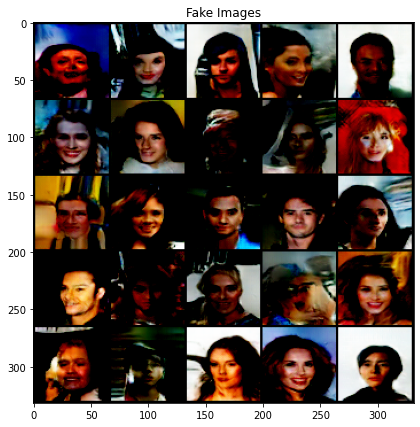

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


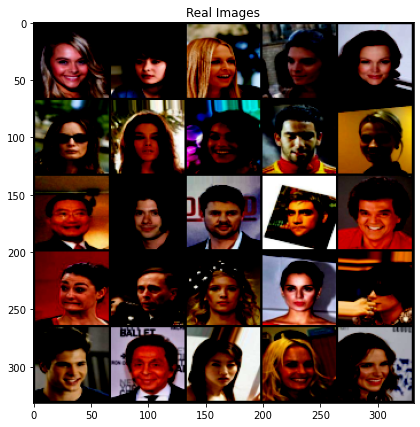

 95%|█████████▍| 1502/1583 [09:38<00:39,  2.04it/s]


Epoch [9/15], Step 54 
Discriminator Loss: 0.1280, Generator Loss: 4.1589


  0%|          | 0/1583 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


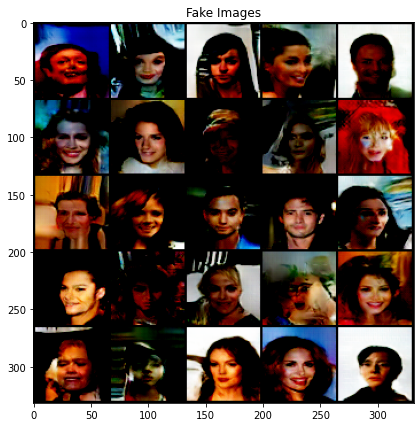

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


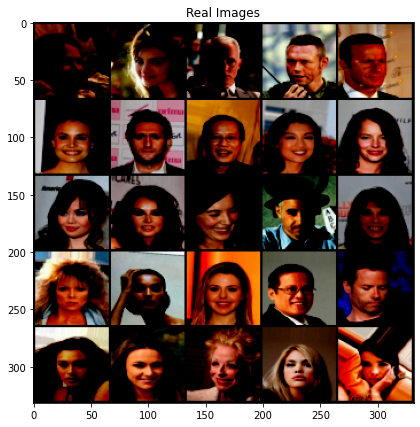

  0%|          | 2/1583 [00:01<15:51,  1.66it/s]


Epoch [10/15], Step 55 
Discriminator Loss: 0.1108, Generator Loss: 3.0061


 19%|█▉        | 300/1583 [01:55<08:12,  2.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


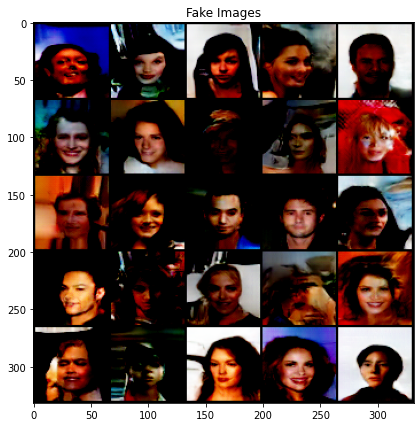

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


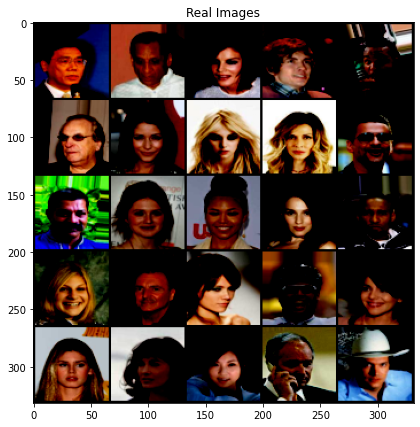

 19%|█▉        | 302/1583 [01:56<10:30,  2.03it/s]


Epoch [10/15], Step 56 
Discriminator Loss: 0.0826, Generator Loss: 3.1099


 38%|███▊      | 600/1583 [03:51<06:19,  2.59it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


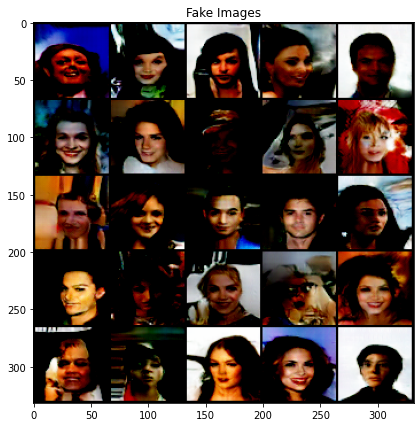

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


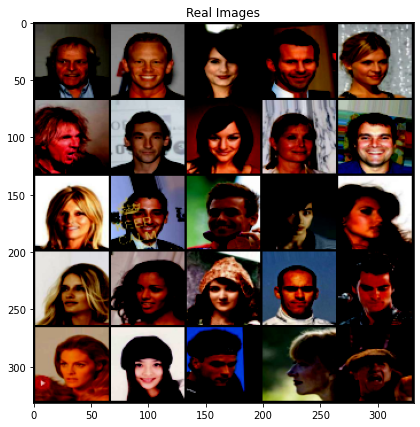

 38%|███▊      | 602/1583 [03:52<08:00,  2.04it/s]


Epoch [10/15], Step 57 
Discriminator Loss: 0.1841, Generator Loss: 1.9968


 57%|█████▋    | 900/1583 [05:46<04:20,  2.62it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


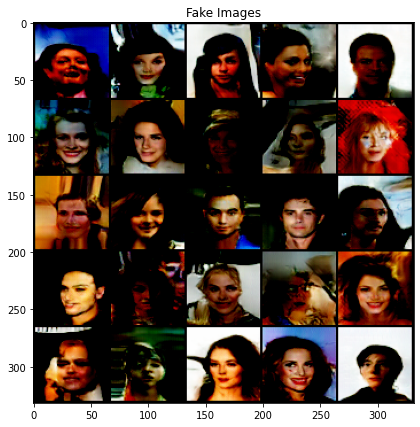

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


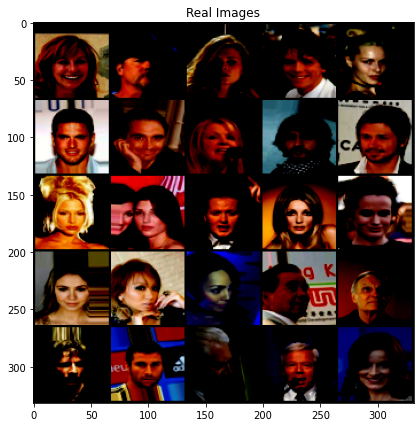

 57%|█████▋    | 902/1583 [05:48<05:44,  1.98it/s]


Epoch [10/15], Step 58 
Discriminator Loss: 0.2288, Generator Loss: 1.5907


 76%|███████▌  | 1200/1583 [07:41<02:26,  2.62it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


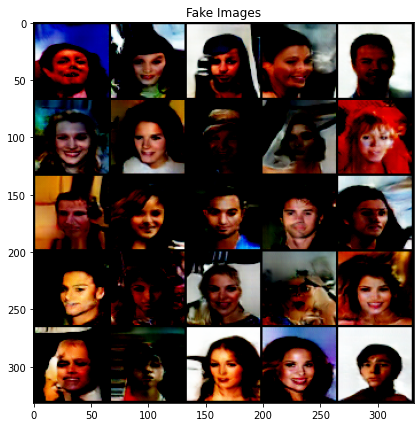

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


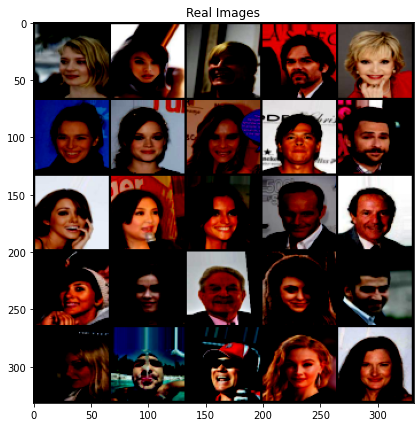

 76%|███████▌  | 1201/1583 [07:43<03:57,  1.61it/s]


Epoch [10/15], Step 59 
Discriminator Loss: 0.0615, Generator Loss: 3.7258


 95%|█████████▍| 1500/1583 [09:37<00:31,  2.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


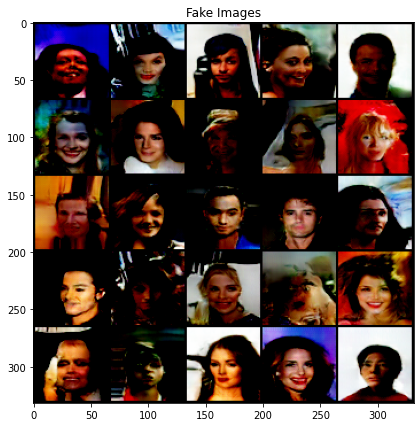

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


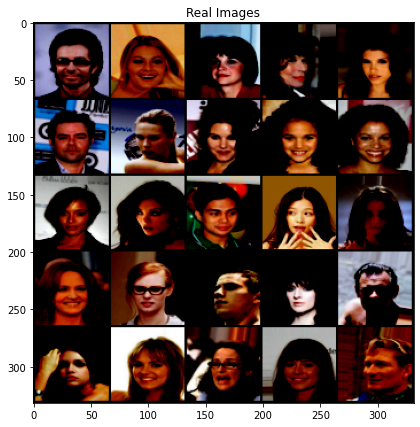

 95%|█████████▍| 1501/1583 [09:38<00:51,  1.59it/s]


Epoch [10/15], Step 60 
Discriminator Loss: 0.0434, Generator Loss: 3.9911


  0%|          | 0/1583 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


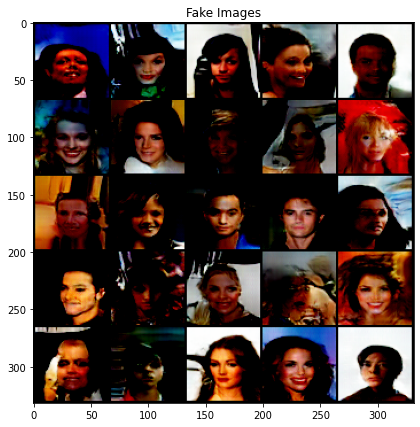

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


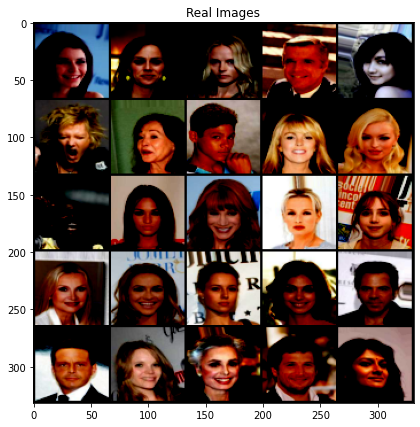

  0%|          | 2/1583 [00:01<15:39,  1.68it/s]


Epoch [11/15], Step 61 
Discriminator Loss: 0.3194, Generator Loss: 7.2807


 19%|█▉        | 300/1583 [01:55<08:10,  2.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


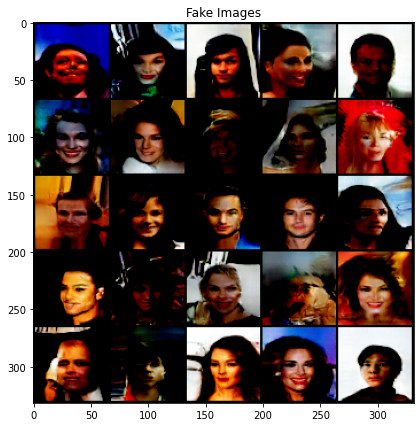

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


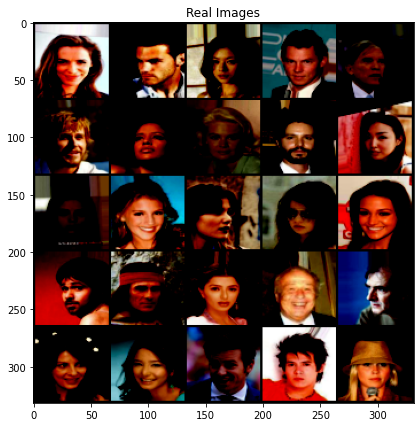

 19%|█▉        | 302/1583 [01:56<10:28,  2.04it/s]


Epoch [11/15], Step 62 
Discriminator Loss: 0.1081, Generator Loss: 3.9360


 38%|███▊      | 600/1583 [03:50<06:16,  2.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


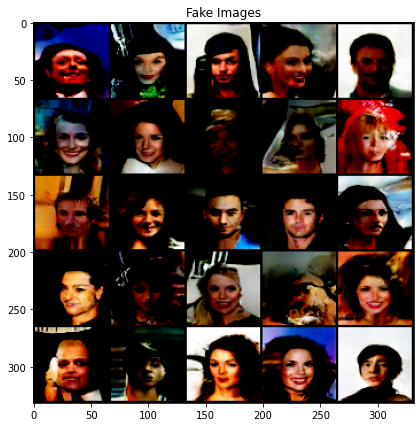

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


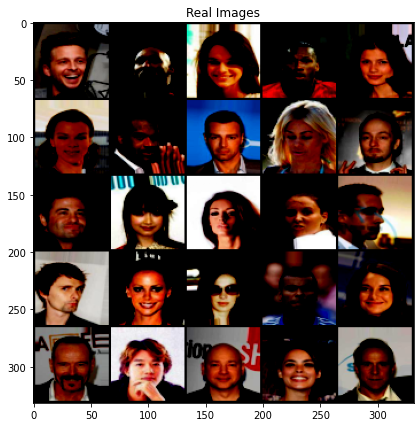

 38%|███▊      | 602/1583 [03:51<08:04,  2.02it/s]


Epoch [11/15], Step 63 
Discriminator Loss: 0.0701, Generator Loss: 4.4057


 57%|█████▋    | 900/1583 [05:45<04:20,  2.62it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


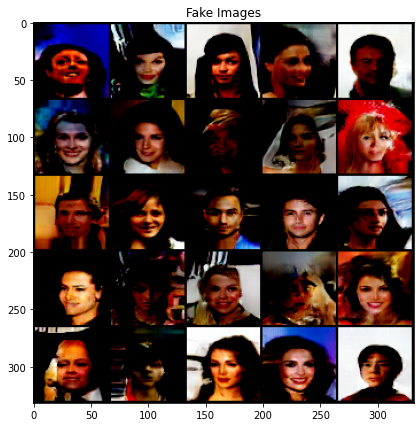

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


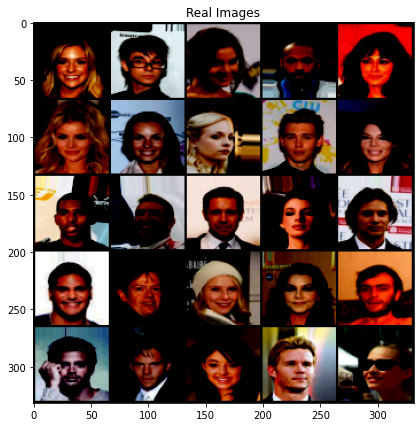

 57%|█████▋    | 901/1583 [05:46<07:04,  1.61it/s]


Epoch [11/15], Step 64 
Discriminator Loss: 0.1234, Generator Loss: 2.9898


 76%|███████▌  | 1200/1583 [07:40<02:26,  2.62it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


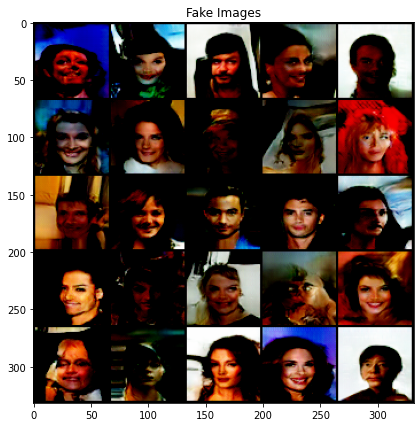

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


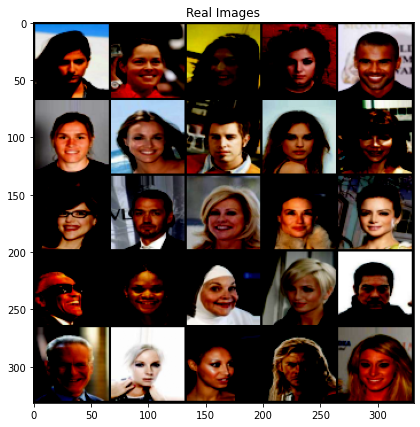

 76%|███████▌  | 1202/1583 [07:42<03:06,  2.04it/s]


Epoch [11/15], Step 65 
Discriminator Loss: 0.0896, Generator Loss: 4.1712


 95%|█████████▍| 1500/1583 [09:36<00:31,  2.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


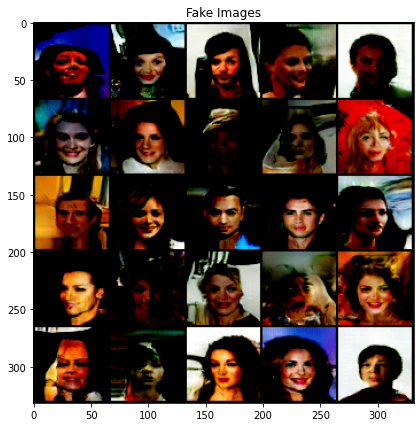

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


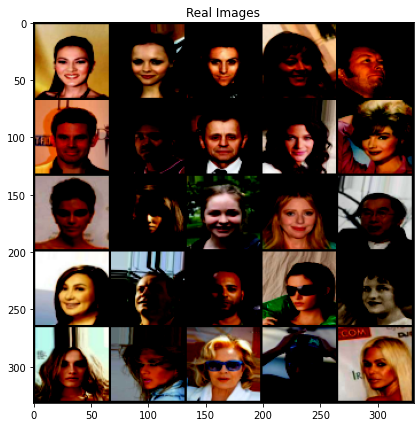

 95%|█████████▍| 1502/1583 [09:37<00:41,  1.96it/s]


Epoch [11/15], Step 66 
Discriminator Loss: 0.0907, Generator Loss: 4.8671


  0%|          | 0/1583 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


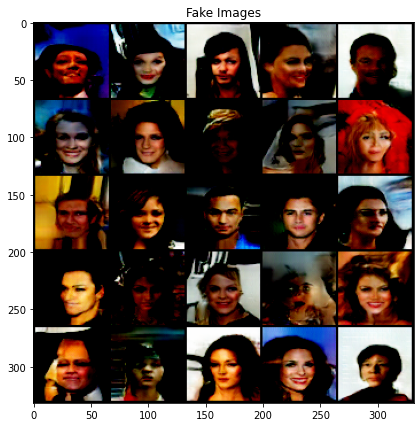

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


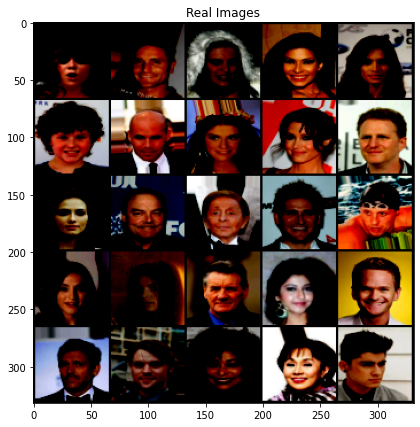

  0%|          | 1/1583 [00:01<32:47,  1.24s/it]


Epoch [12/15], Step 67 
Discriminator Loss: 0.1042, Generator Loss: 4.5378


 19%|█▉        | 300/1583 [01:55<08:08,  2.62it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


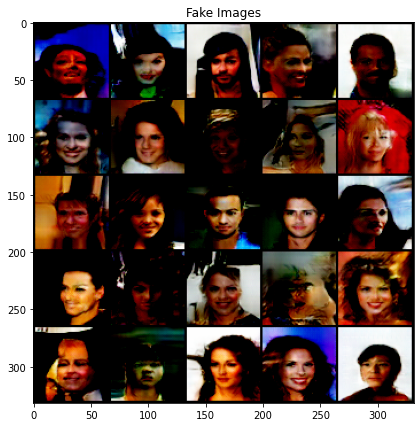

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


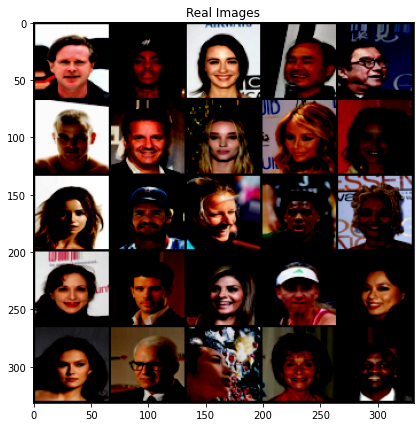

 19%|█▉        | 302/1583 [01:56<10:28,  2.04it/s]


Epoch [12/15], Step 68 
Discriminator Loss: 0.0827, Generator Loss: 3.8209


 38%|███▊      | 600/1583 [03:50<06:16,  2.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


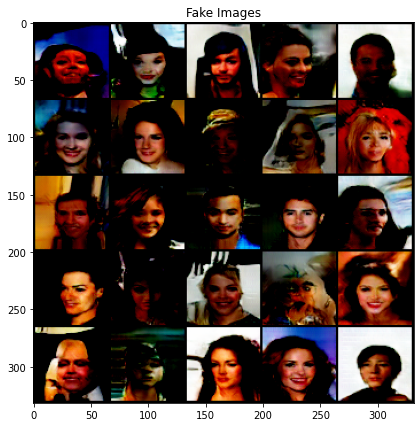

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


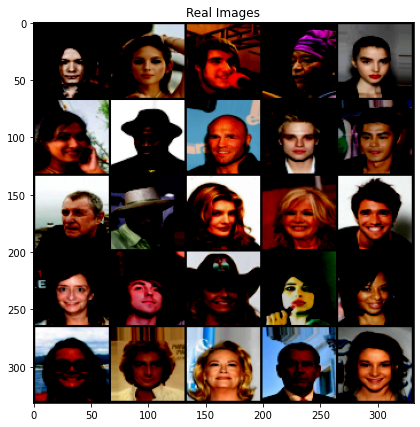

 38%|███▊      | 602/1583 [03:51<08:00,  2.04it/s]


Epoch [12/15], Step 69 
Discriminator Loss: 0.2877, Generator Loss: 5.0178


 57%|█████▋    | 900/1583 [05:45<04:20,  2.62it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


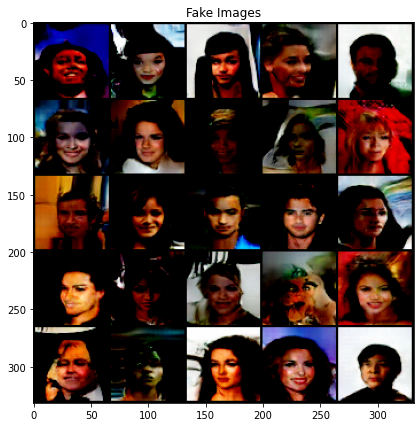

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


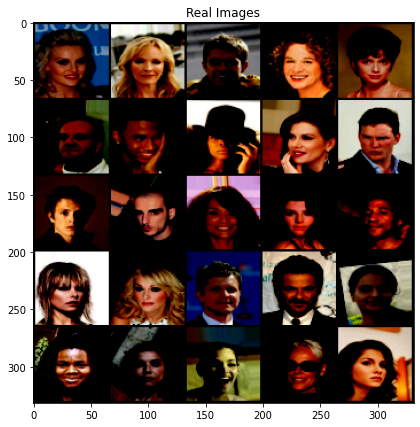

 57%|█████▋    | 902/1583 [05:47<05:37,  2.02it/s]


Epoch [12/15], Step 70 
Discriminator Loss: 0.1273, Generator Loss: 2.3406


 76%|███████▌  | 1200/1583 [07:40<02:26,  2.62it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


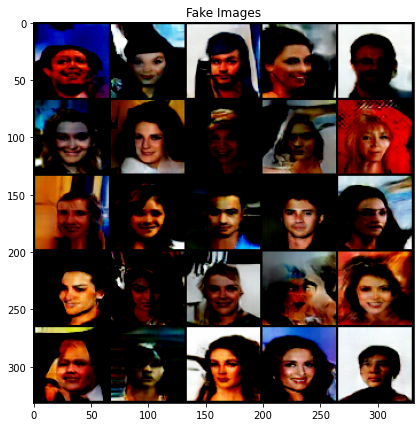

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


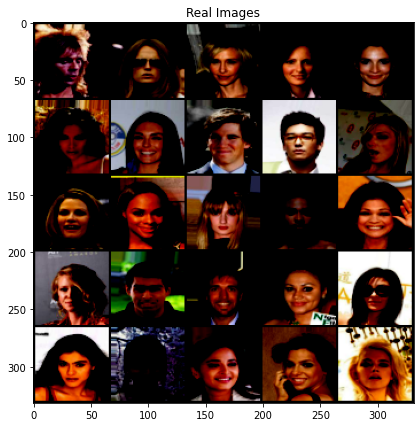

 76%|███████▌  | 1202/1583 [07:42<03:05,  2.05it/s]


Epoch [12/15], Step 71 
Discriminator Loss: 1.1012, Generator Loss: 7.4953


 95%|█████████▍| 1500/1583 [09:36<00:31,  2.62it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


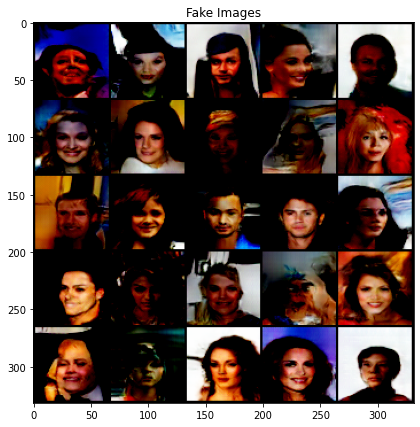

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


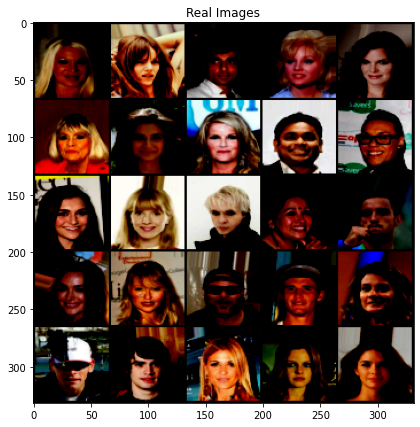

 95%|█████████▍| 1502/1583 [09:37<00:40,  1.99it/s]


Epoch [12/15], Step 72 
Discriminator Loss: 0.3631, Generator Loss: 6.2788


  0%|          | 0/1583 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


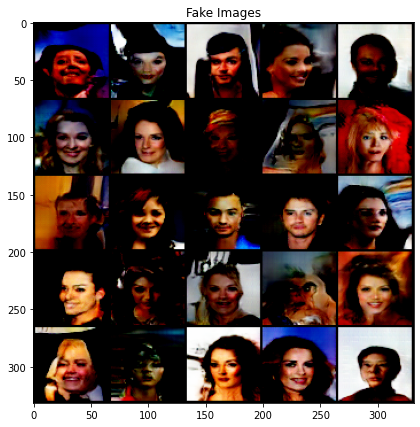

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


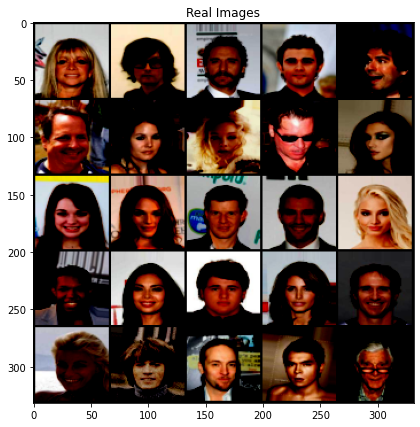

  0%|          | 2/1583 [00:01<16:11,  1.63it/s]


Epoch [13/15], Step 73 
Discriminator Loss: 0.0223, Generator Loss: 5.6550


 19%|█▉        | 300/1583 [01:55<08:09,  2.62it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


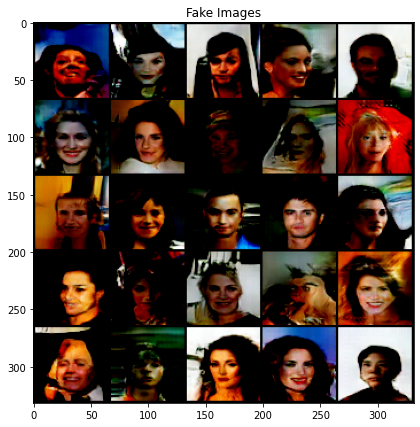

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


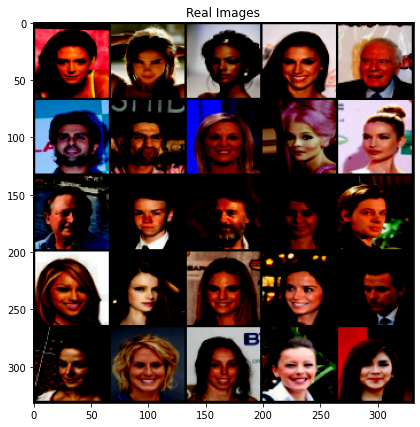

 19%|█▉        | 302/1583 [01:56<10:37,  2.01it/s]


Epoch [13/15], Step 74 
Discriminator Loss: 0.0870, Generator Loss: 3.9029


 38%|███▊      | 600/1583 [03:50<06:15,  2.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


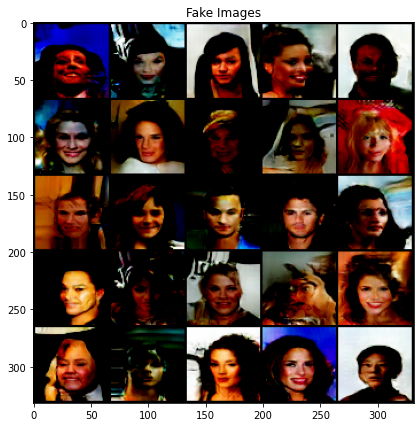

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


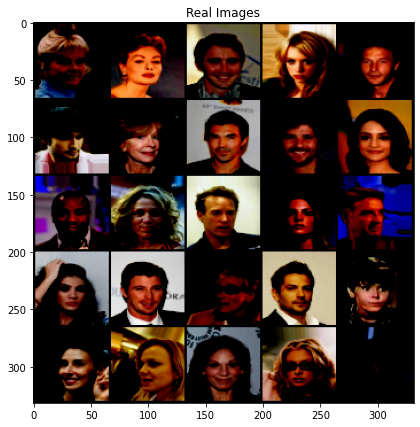

 38%|███▊      | 602/1583 [03:51<08:02,  2.03it/s]


Epoch [13/15], Step 75 
Discriminator Loss: 0.2031, Generator Loss: 5.8273


 57%|█████▋    | 900/1583 [05:45<04:19,  2.63it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


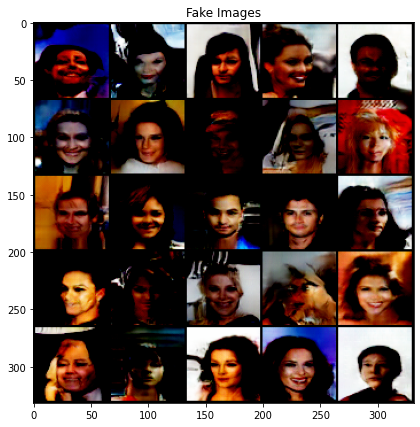

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


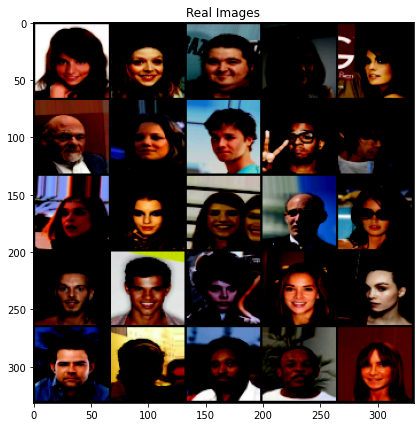

 57%|█████▋    | 901/1583 [05:46<07:05,  1.60it/s]


Epoch [13/15], Step 76 
Discriminator Loss: 0.0646, Generator Loss: 5.1806


 76%|███████▌  | 1200/1583 [07:40<02:26,  2.62it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


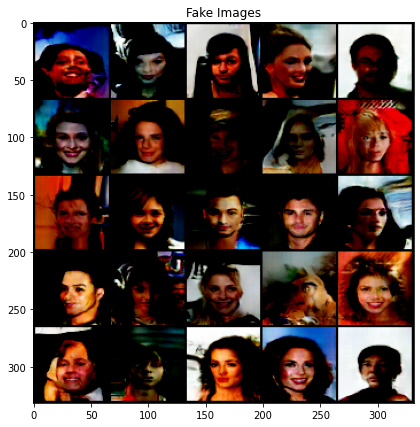

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


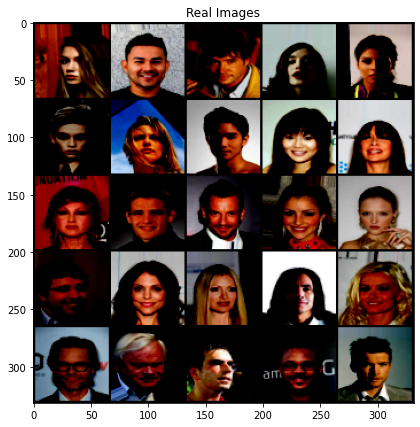

 76%|███████▌  | 1202/1583 [07:41<03:04,  2.06it/s]


Epoch [13/15], Step 77 
Discriminator Loss: 0.0990, Generator Loss: 3.0684


 95%|█████████▍| 1500/1583 [09:35<00:31,  2.62it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


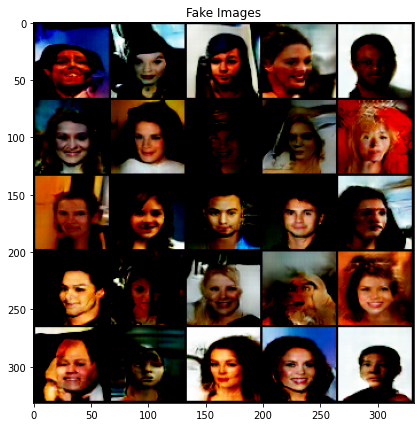

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


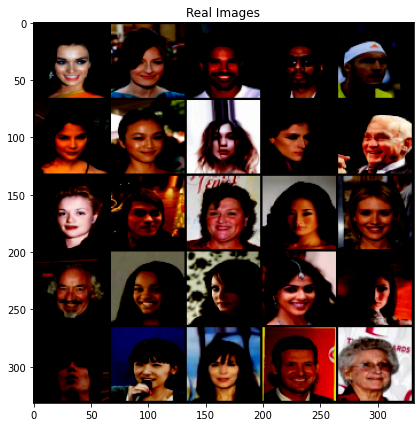

 95%|█████████▍| 1501/1583 [09:37<00:51,  1.59it/s]


Epoch [13/15], Step 78 
Discriminator Loss: 0.1710, Generator Loss: 3.4266


  0%|          | 0/1583 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


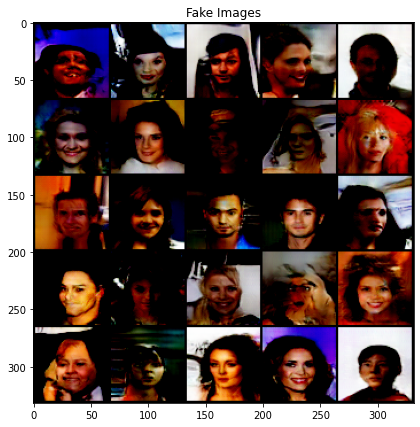

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


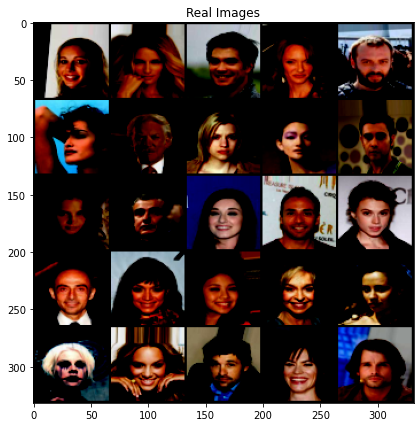

  0%|          | 2/1583 [00:01<15:32,  1.70it/s]


Epoch [14/15], Step 79 
Discriminator Loss: 0.8196, Generator Loss: 1.2115


 19%|█▉        | 300/1583 [01:55<08:11,  2.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


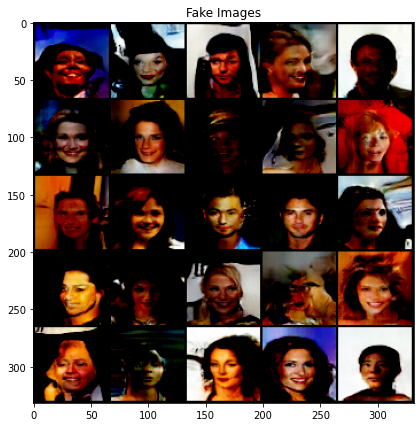

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


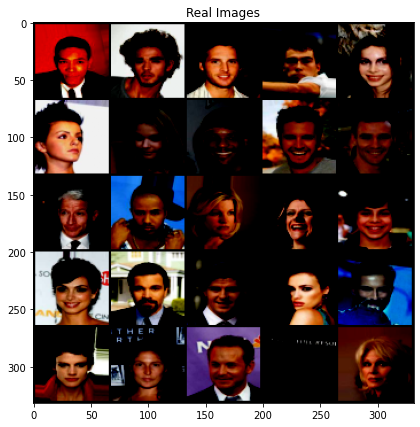

 19%|█▉        | 301/1583 [01:56<13:10,  1.62it/s]


Epoch [14/15], Step 80 
Discriminator Loss: 0.0482, Generator Loss: 3.8540


 38%|███▊      | 600/1583 [03:50<06:14,  2.62it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


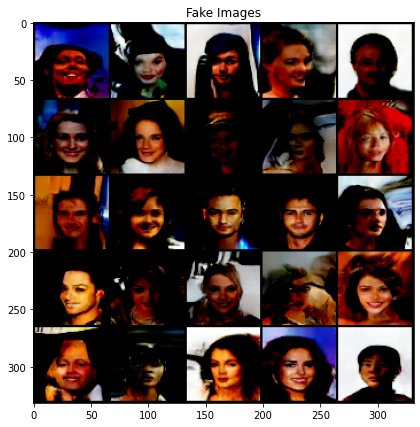

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


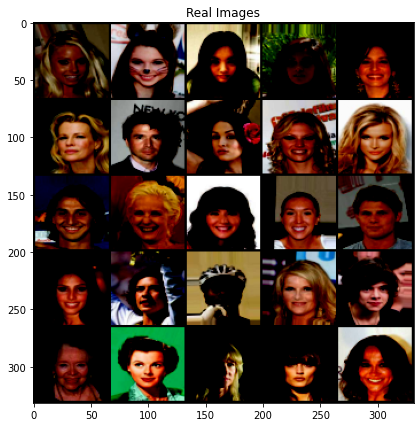

 38%|███▊      | 602/1583 [03:51<08:11,  2.00it/s]


Epoch [14/15], Step 81 
Discriminator Loss: 0.0472, Generator Loss: 4.5657


 57%|█████▋    | 900/1583 [05:46<04:22,  2.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


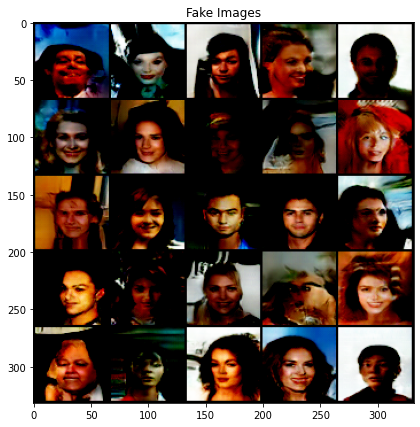

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


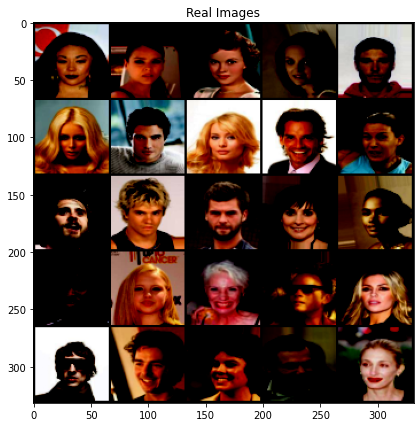

 57%|█████▋    | 902/1583 [05:47<05:33,  2.04it/s]


Epoch [14/15], Step 82 
Discriminator Loss: 0.0294, Generator Loss: 4.7000


 76%|███████▌  | 1200/1583 [07:41<02:26,  2.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


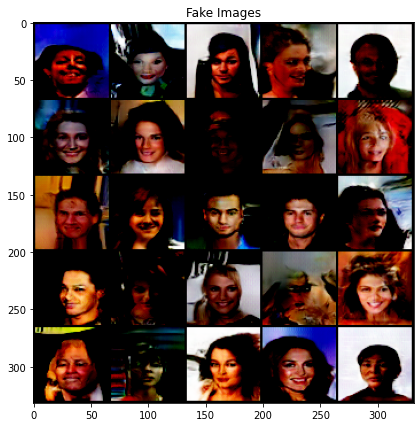

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


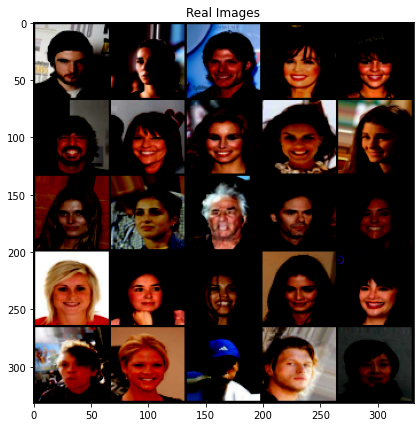

 76%|███████▌  | 1201/1583 [07:42<03:55,  1.62it/s]


Epoch [14/15], Step 83 
Discriminator Loss: 0.0757, Generator Loss: 5.1322


 95%|█████████▍| 1500/1583 [09:36<00:31,  2.60it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


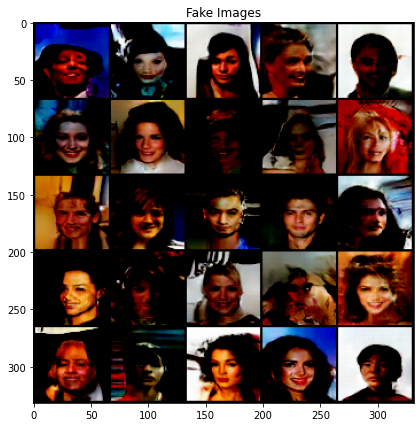

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


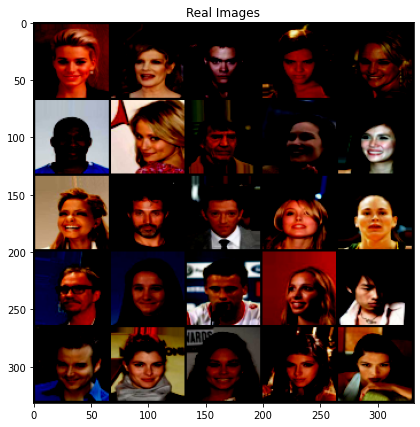

 95%|█████████▍| 1502/1583 [09:37<00:39,  2.04it/s]


Epoch [14/15], Step 84 
Discriminator Loss: 0.3536, Generator Loss: 1.0705


  0%|          | 0/1583 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


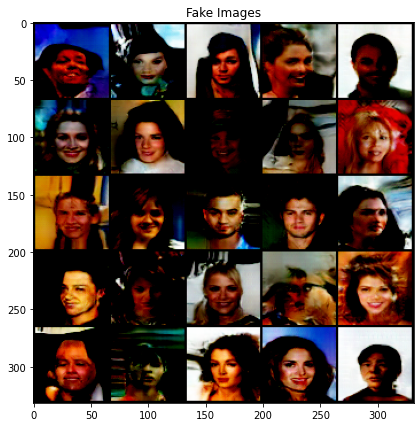

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


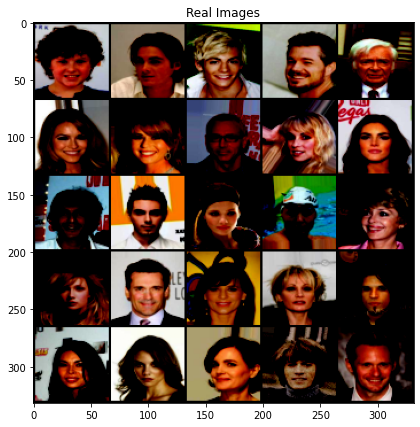

  0%|          | 2/1583 [00:01<15:34,  1.69it/s]


Epoch [15/15], Step 85 
Discriminator Loss: 0.0573, Generator Loss: 3.5819


 19%|█▉        | 300/1583 [01:55<08:10,  2.62it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


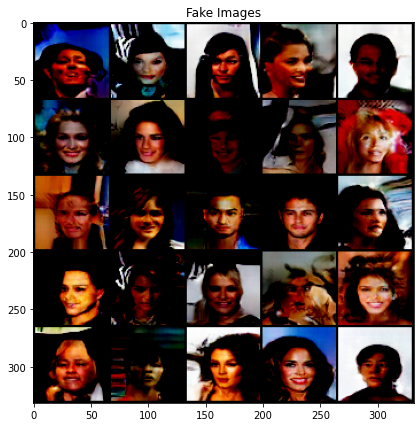

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


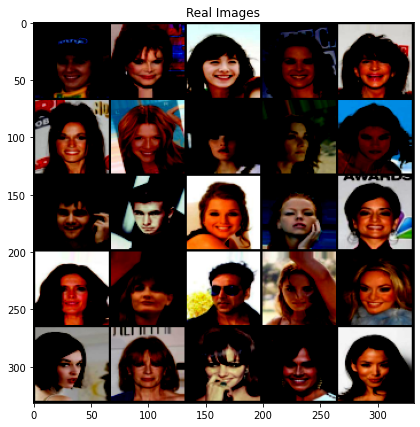

 19%|█▉        | 302/1583 [01:56<10:34,  2.02it/s]


Epoch [15/15], Step 86 
Discriminator Loss: 0.0614, Generator Loss: 4.3151


 38%|███▊      | 600/1583 [03:50<06:15,  2.62it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


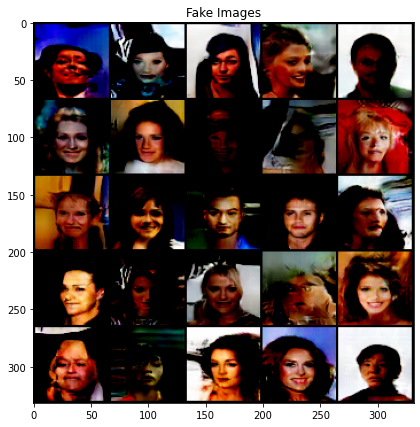

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


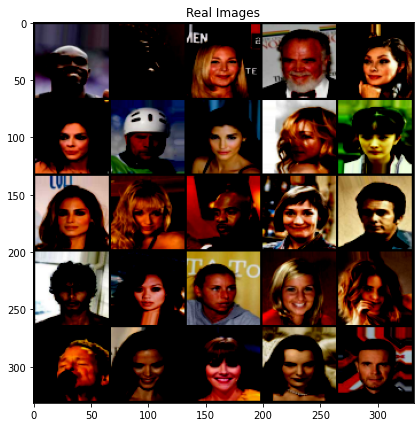

 38%|███▊      | 602/1583 [03:51<08:09,  2.00it/s]


Epoch [15/15], Step 87 
Discriminator Loss: 0.1604, Generator Loss: 2.3990


 57%|█████▋    | 900/1583 [05:45<04:21,  2.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


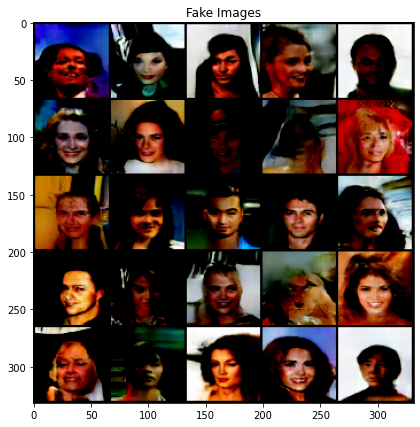

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


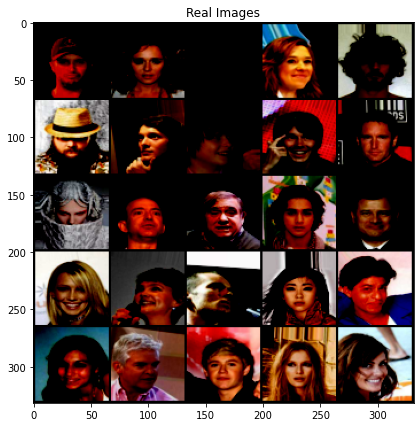

 57%|█████▋    | 902/1583 [05:47<05:46,  1.96it/s]


Epoch [15/15], Step 88 
Discriminator Loss: 0.0617, Generator Loss: 4.3396


 76%|███████▌  | 1200/1583 [07:41<02:26,  2.62it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


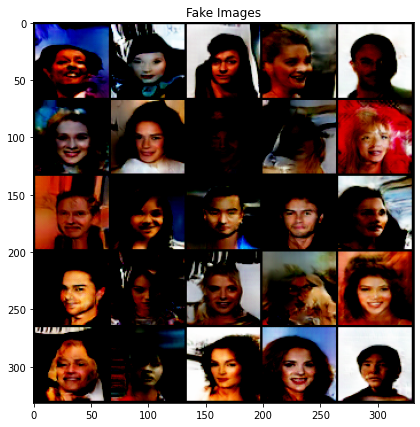

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


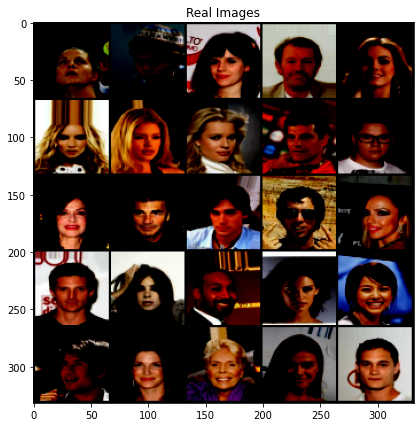

 76%|███████▌  | 1202/1583 [07:42<03:05,  2.05it/s]


Epoch [15/15], Step 89 
Discriminator Loss: 0.4046, Generator Loss: 5.9352


 95%|█████████▍| 1500/1583 [09:36<00:31,  2.61it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


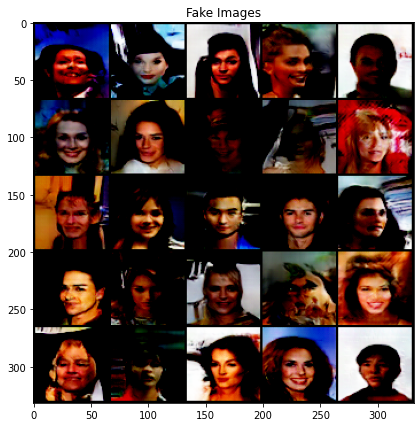

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


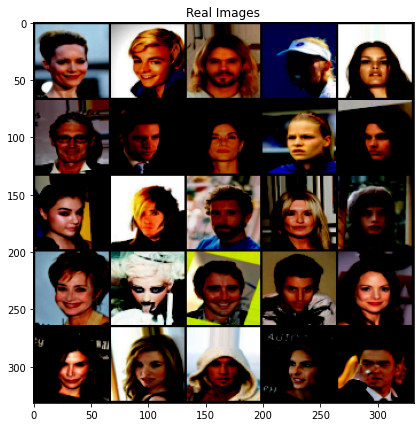

 95%|█████████▍| 1502/1583 [09:37<00:39,  2.04it/s]


Epoch [15/15], Step 90 
Discriminator Loss: 0.0881, Generator Loss: 3.8009


100%|██████████| 1583/1583 [10:08<00:00,  2.60it/s]


In [20]:
import tqdm

step = 0
 
for epoch in range(n_epochs):
    for batch_idx, (real, _) in enumerate(tqdm.tqdm(loader)):
        
        real = real.to(device)
        noise = torch.randn((batch_size, z_dim, 1, 1)).to(device)
        fake = gen(noise)
        
        disc_real = disc(real).reshape(-1)
        loss_disc_real = criterion(disc_real, torch.ones_like(disc_real))
        
        disc_fake = disc(fake).reshape(-1)
        loss_disc_fake = criterion(disc_fake, torch.zeros_like(disc_fake))
        
        lossD = (loss_disc_real + loss_disc_fake) / 2.0
        
        disc.zero_grad()
        lossD.backward(retain_graph=True)
        opt_disc.step()
        
        
        output = disc(fake).reshape(-1).to(device)
        lossG = criterion(output, torch.ones_like(output))
        gen.zero_grad()
        lossG.backward()
        opt_gen.step()
        
        if batch_idx % 300 == 0:
            
                
            with torch.no_grad():
                fake = gen(fixed_noise).reshape(-1, 3, 64, 64).to(device)
                data = real.reshape(-1, 3, 64, 64).to(device)
                
                plt.figure(figsize=(7, 7))
                show_tensor_images(fake, num_images=25)
                plt.figure(figsize=(7, 7))
                show_tensor_images(data, num_images=25, title='Real Images')

                #writer_real.add_image('LinearGAN MNIST Discriminator', img_real_grid, global_step=step)
                
                #writer_fake.add_image('LinearGAN MNIST Generator', img_fake_grid, global_step=step)
    
            step+=1  
        
        if batch_idx % 300 == 0:
            
            print(
                 f"\nEpoch [{epoch+1}/{n_epochs}], Step {step} \nDiscriminator Loss: {lossD:.4f}, Generator Loss: {lossG:.4f}"
            )

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


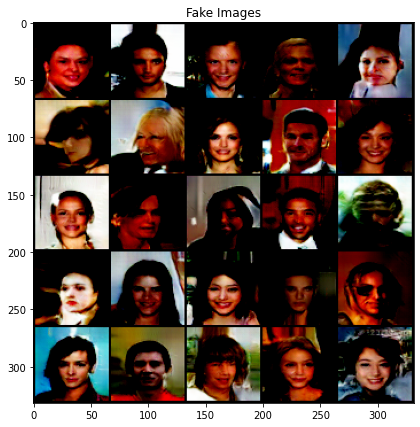

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


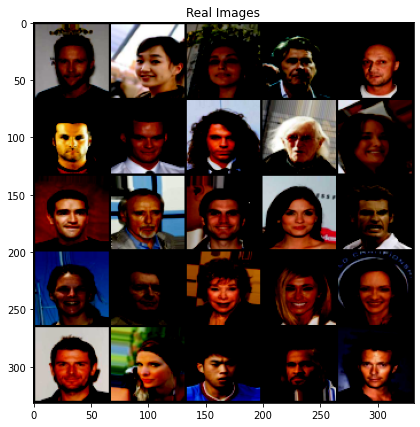

In [21]:
z = torch.randn(25, 100, 1, 1).to(device)
out = gen(z)

plt.figure(figsize=(7, 7))
show_tensor_images(out, num_images=25)
plt.figure(figsize=(7, 7))
show_tensor_images(real, num_images=25, title='Real Images')